In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
from glob import glob
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib as mpl
from matplotlib.pyplot import rc_context
import os
import seaborn as sns
import harmonypy as hm
import importlib
import re
import random

In [2]:
from sklearn import svm
from sklearn import metrics
from sklearn.metrics import plot_roc_curve, plot_precision_recall_curve
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white', dpi_save=600)

scanpy==1.8.2 anndata==0.7.5 umap==0.5.2 numpy==1.20.3 scipy==1.5.3 pandas==1.3.5 scikit-learn==1.0.1 statsmodels==0.12.2 python-igraph==0.9.8 pynndescent==0.5.5


# Load data

In [4]:
os.chdir('../../../..')

In [5]:
pwd

'/Users/tzuchiao/ProjectAnalysis/AFCA'

In [6]:
fcaDatasetFolder='../FCA/dataset'
fcaH5adFolder='../FCA/dataset/h5ad'
fcaLoomFolder='../FCA/dataset/loom'

In [7]:
harmonyAnalysisFolder=f'Analysis/4.harmony'

In [8]:
leiden_L=['leiden_%.1f' % x for x in list(np.arange(1.0, 11.0, 1.0)) + list(np.arange(20.0, 60.0, 10.0)) ]

In [9]:
age_L=['5', '30', '50', '70']
ageColor_L=['#1F77B4', '#FF7F0E', '#2CA02C', '#D62728']
ageColor_L2=['#009ACD', '#FF7D40', '#2CA02C', '#D62728']
ggplotColor3_L= ["#F8766D", "#00BA38", "#619CFF"]
set2Color_L=["#66C2A5", "#E9936A", "#A89BB0"]

In [10]:
allHeadBodyDataFolder=f'{harmonyAnalysisFolder}/afcaFca_headBody_v1.0/normalizedCounts'

os.makedirs(allHeadBodyDataFolder, exist_ok=True)
allHeadBodyPicFolder=f'{allHeadBodyDataFolder}/pic'
os.makedirs(allHeadBodyPicFolder, exist_ok=True)

In [11]:
figureDataFolder=f'Analysis/Figure'
# figureDataFolder=f'Analysis/Figure_github'
os.makedirs(figureDataFolder, exist_ok=True)
figure1Folder=f'{figureDataFolder}/Figure1'
os.makedirs(figure1Folder, exist_ok=True)
figureFolder=f'{figureDataFolder}/Figure2'
os.makedirs(figureFolder, exist_ok=True)
figurePicFolder=f'{figureFolder}/pic'
os.makedirs(figurePicFolder, exist_ok=True)

In [12]:
cellnFolder=f'{figureFolder}/cellN'
os.makedirs(cellnFolder, exist_ok=True)

compositionFolder=f'{figureFolder}/composition'
os.makedirs(compositionFolder, exist_ok=True)

# Figure 2A

In [16]:
adata_concat_harmony=sc.read(f'{figure1Folder}/7.linearR_annotation_broad.h5ad')

In [17]:
adata_concat_harmony

AnnData object with n_obs × n_vars = 868209 × 2348
    obs: 'cellBC', 'sampleGroup', 'sex', 'tissue', 'age', 'sampleN', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rRNA', 'pct_counts_rRNA', 'batch', 'dataset', 'fca_id', 'R_annotation', 'R_annotation__ontology_id', 'R_annotation_broad', 'R_annotation_broad__ontology_id', 'annotation', 'annotation__ontology_id', 'annotation_broad', 'annotation_broad__ontology_id', 'annotation_broad_extrapolated', 'annotation_broad_extrapolated__ontology_id', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_rRNA', 'leiden', 'leiden_1.0', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'leiden_20.0', 'leiden_30.0', 'leiden_40.0', 'leiden_50.0', 'sex_age', 'linearR_annotation', 'afca_annotation', 'S_annotation', 'S_annotation__ontology_id', 'S_annotation_broad', 'S_annotation_broad_

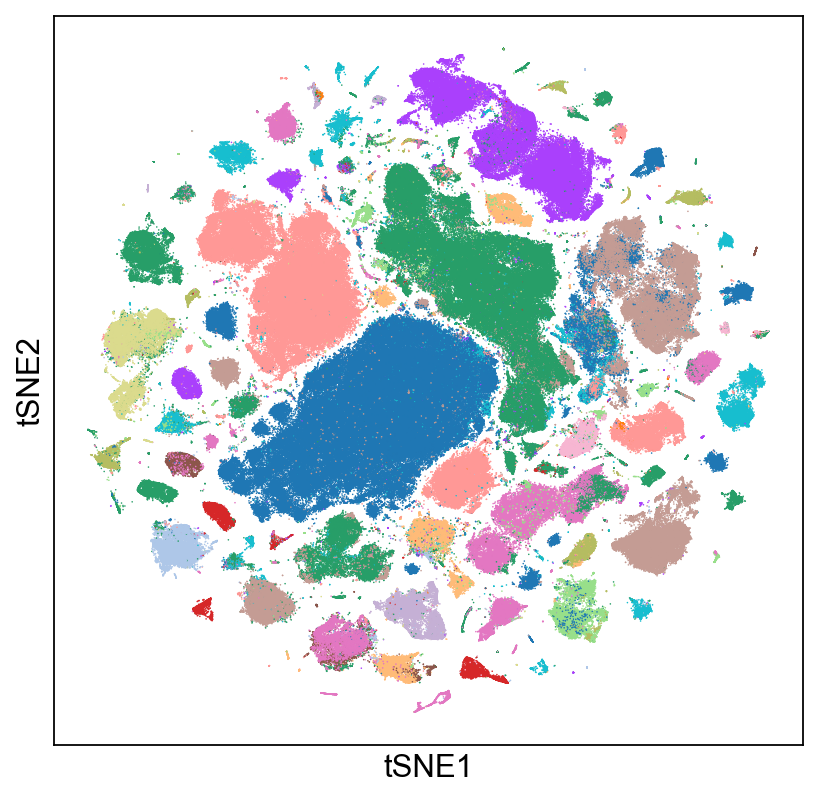

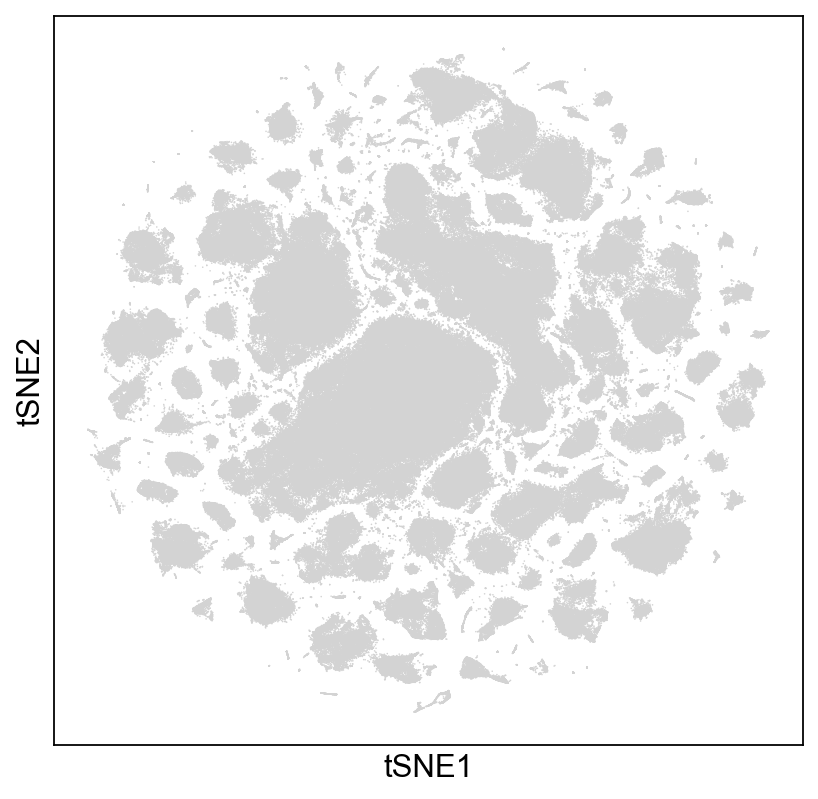

In [119]:
with rc_context({'figure.figsize': (6, 6)}):
    # fig, ax=
    sc.pl.tsne(adata_concat_harmony, color='linearR_annotation_broad', size=2, save=f'_Fig2A_color.pdf', title='', legend_loc=None)
    # ax.get_legend().remove()
    # plt.show()
    
    sc.pl.tsne(adata_concat_harmony, color='linearR_annotation_broad', size=2, groups='CNS', na_in_legend=False, save=f'_Fig2A_grey.pdf',title='', legend_loc=None)
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

In [22]:
fca_L, afca_L=[], []
for i, annot in enumerate(adata_concat_harmony.obs.afca_annotation):
    dataset=adata_concat_harmony.obs.dataset[i]
    
    if dataset == 'FCA':
        fca_L.append(annot)
        afca_L.append(np.nan)
    else:
        fca_L.append(np.nan)
        afca_L.append(annot)


In [23]:
adata_concat_harmony.obs['FCA_annotation']=pd.Categorical(fca_L)
adata_concat_harmony.obs['AFCA_annotation']=pd.Categorical(afca_L)

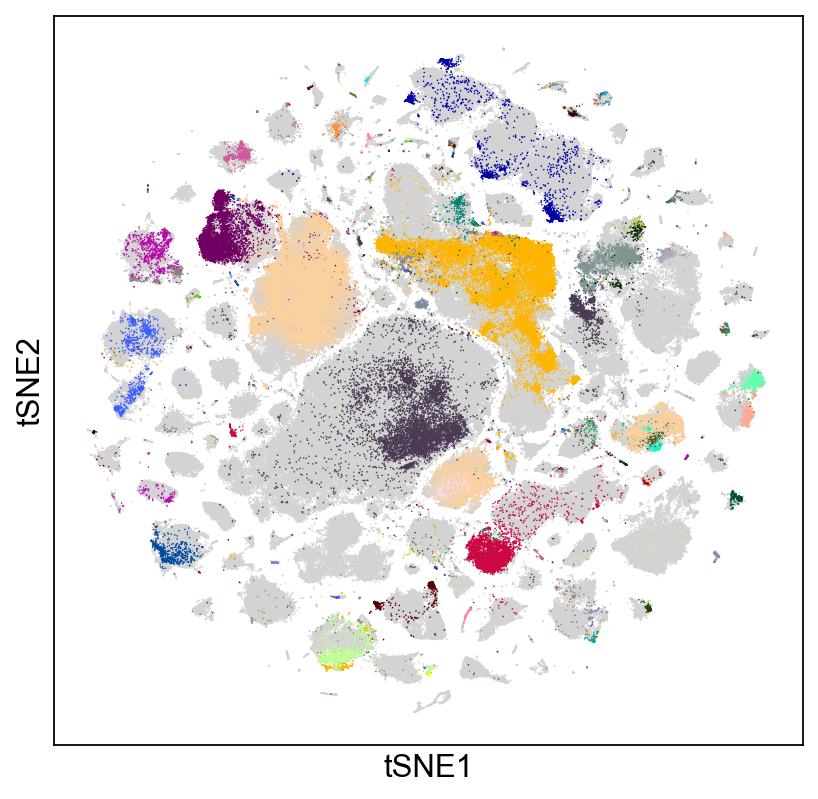

In [75]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_concat_harmony, color='FCA_annotation', size=2, save=f'_Fig2A_FCA.pdf', title='', legend_loc=None)    
    # sc.pl.tsne(adata_concat_harmony, color='AFCA_annotation', size=2, save=f'_Fig2A_AFCA.pdf', title='', legend_loc=None)
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

# Figure 2B

In [14]:
adata_head=sc.read(f'{allHeadBodyDataFolder}/adata_head_S_v1.0.h5ad')
adata_body=sc.read(f'{allHeadBodyDataFolder}/adata_body_S_v1.0.h5ad')

In [15]:
with rc_context({'figure.figsize': (6, 6)}):
#         sc.pl.tsne(adata_head, color='afca_annotation', show=False, title='', save=f'_Fig2B_head_afca_annotation.pdf')
#         sc.pl.tsne(adata_body, color='afca_annotation', show=False, title='', save=f'_Fig2B_body_afca_annotation.pdf')
        
#         sc.pl.tsne(adata_head, color='afca_annotation', show=False, title='', save=f'_Fig2B_head_afca_annotation_size1.pdf', size=1)
#         sc.pl.tsne(adata_body, color='afca_annotation', show=False, title='', save=f'_Fig2B_body_afca_annotation_size1.pdf', size=1)
        
        sc.pl.tsne(adata_head, color='afca_annotation', show=False, title='', save=f'_Fig2B_head_afca_annotation_size2.pdf', size=2)
        sc.pl.tsne(adata_body, color='afca_annotation', show=False, title='', save=f'_Fig2B_body_afca_annotation_size2.pdf', size=2)
        
        
#         sc.pl.umap(adata_head, color='afca_annotation', show=False, title='', save=f'_Fig2B_head_afca_annotation.pdf')
#         sc.pl.umap(adata_body, color='afca_annotation', show=False, title='', save=f'_Fig2B_body_afca_annotation.pdf')

#         sc.pl.umap(adata_head, color='afca_annotation', show=False, title='', save=f'_Fig2B_head_afca_annotation_size1.pdf', size=1)
#         sc.pl.umap(adata_body, color='afca_annotation', show=False, title='', save=f'_Fig2B_body_afca_annotation_size1.pdf', size=1)
        
        sc.pl.umap(adata_head, color='afca_annotation', show=False, title='', save=f'_Fig2B_head_afca_annotation_size2.pdf', size=2)
        sc.pl.umap(adata_body, color='afca_annotation', show=False, title='', save=f'_Fig2B_body_afca_annotation_size2.pdf', size=2)
        
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

# Figure 2C: Highlight new neuron clusters

In [13]:
adata_head=sc.read(f'{allHeadBodyDataFolder}/adata_head_S_v1.0.h5ad')
adata_body=sc.read(f'{allHeadBodyDataFolder}/adata_body_S_v1.0.h5ad')

In [14]:
newNeuron_L = [x for x in adata_head.obs.afca_annotation.cat.categories if re.match('^neuron \d{1,2}$', x) is not None]

## Highlight new neuron clusters

In [17]:
adata_head.obs['newNeuron'] = pd.Categorical(['Y' if x in newNeuron_L else np.nan for x in adata_head.obs.afca_annotation ])

In [18]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_head, color='afca_annotation', groups=newNeuron_L, na_in_legend=False, show=False, size=3, title='Neuron clusters', na_color='whitesmoke', legend_loc=None,
               save=f'_newNeuronClusters.pdf')
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

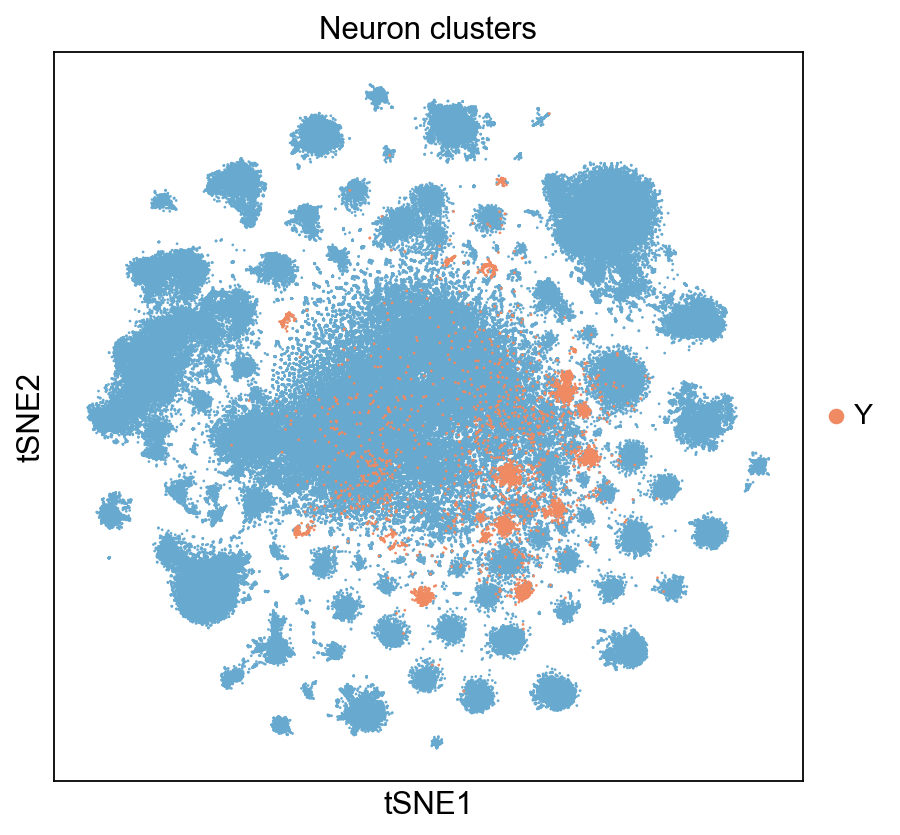

In [19]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_head, color='newNeuron', na_in_legend=False, size=6, title='Neuron clusters', na_color='#67a9cf', palette=['#ef8a62'], # na_color='whitesmoke', ['#ef8a62','#f7f7f7','#67a9cf']
               save=f'_newNeuron_oneColor.pdf') # show=False,  # palette=['#e41a1c'],
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

## Subcluster new neurons

In [15]:
adata_head_neuron = adata_head[adata_head.obs.afca_annotation.isin(newNeuron_L)]
adata_head_neuron

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


View of AnnData object with n_obs × n_vars = 9922 × 15992
    obs: 'tissue', 'sex', 'age', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'dataset', 'fca_annotation', 'afca_annotation', 'afca_annotation_broad'
    uns: 'afca_annotation_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'

In [18]:
sc.pp.highly_variable_genes(adata_head_neuron, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:00)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [19]:
adata_head_neuron.raw = adata_head_neuron

In [20]:
adata_head_neuron = adata_head_neuron[:, adata_head_neuron.var.highly_variable]

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


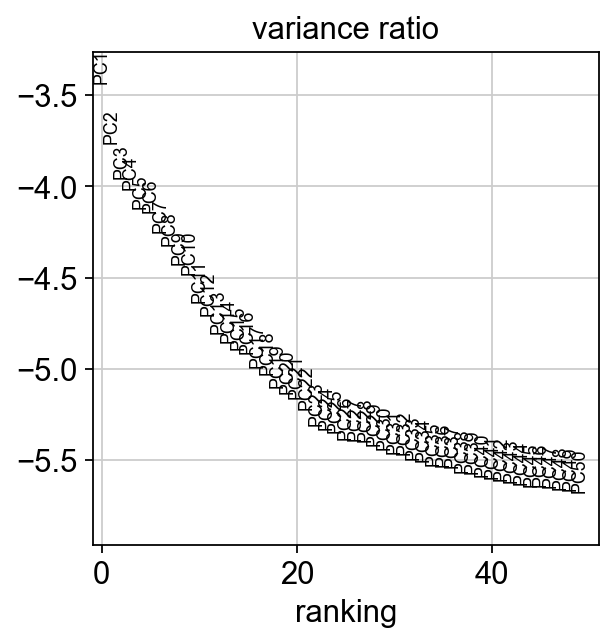

In [21]:
sc.tl.pca(adata_head_neuron, svd_solver='arpack', n_comps=50)
sc.pl.pca_variance_ratio(adata_head_neuron, log=True, n_pcs=50)

In [22]:
### Computing the neighborhood graph
sc.pp.neighbors(adata_head_neuron, n_neighbors=15, n_pcs=25)

### Embedding the neighborhood graph
sc.tl.tsne(adata_head_neuron, n_pcs=25)
sc.tl.umap(adata_head_neuron, )

### Clustering the neighborhood graph
sc.tl.leiden(adata_head_neuron) # resolution=2

computing neighbors
    using 'X_pca' with n_pcs = 25


OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:16)
computing tSNE
    using 'X_pca' with n_pcs = 25
    using sklearn.manifold.TSNE


/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:24)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:14)
running Leiden clustering
    finished: found 22 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


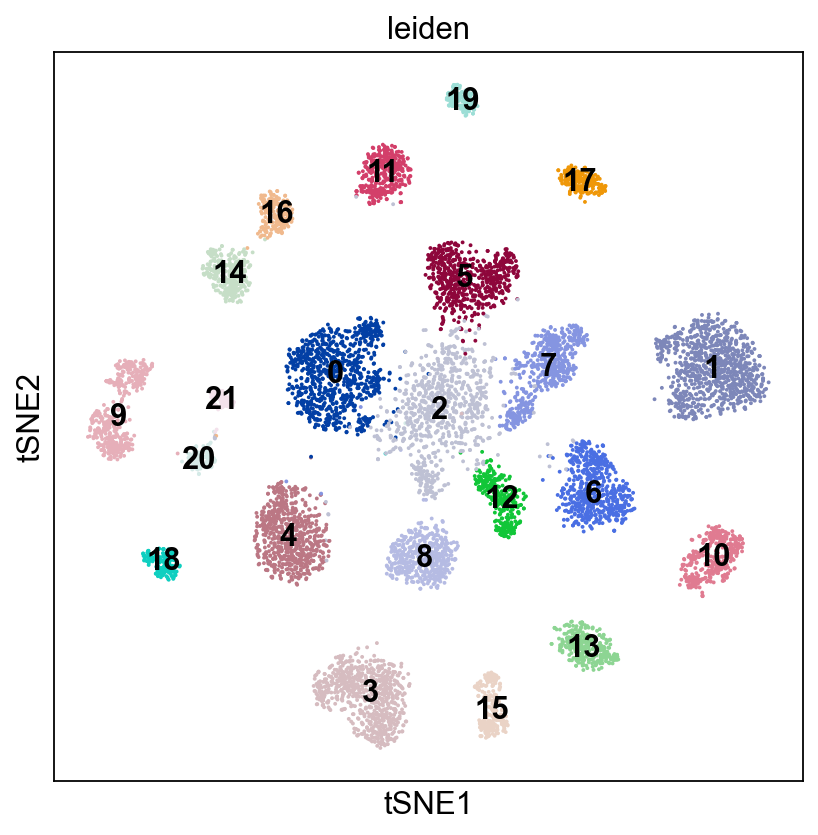

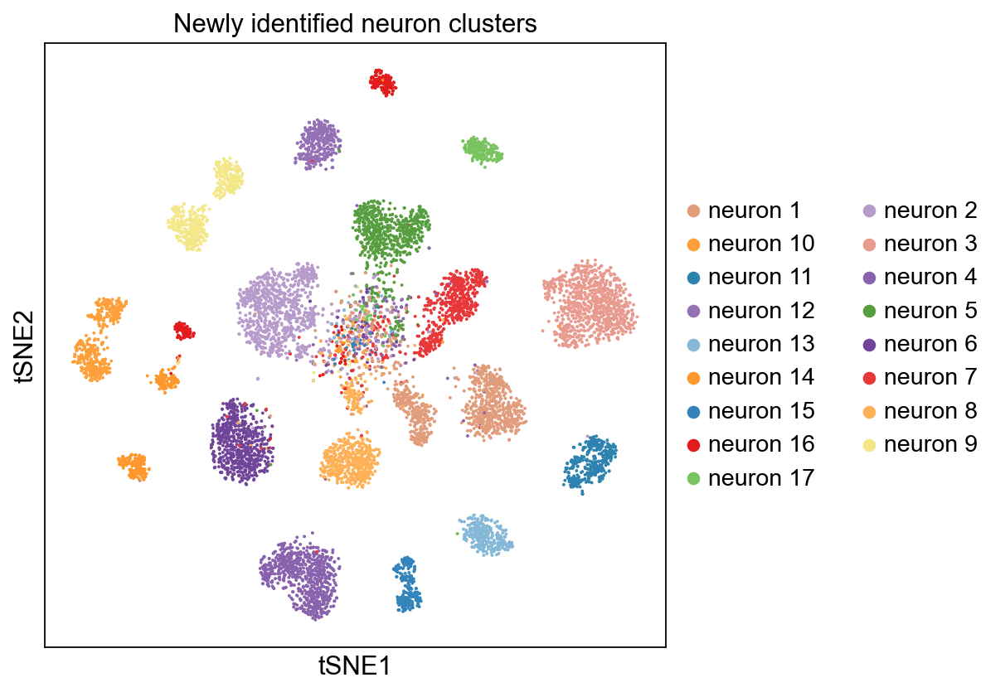

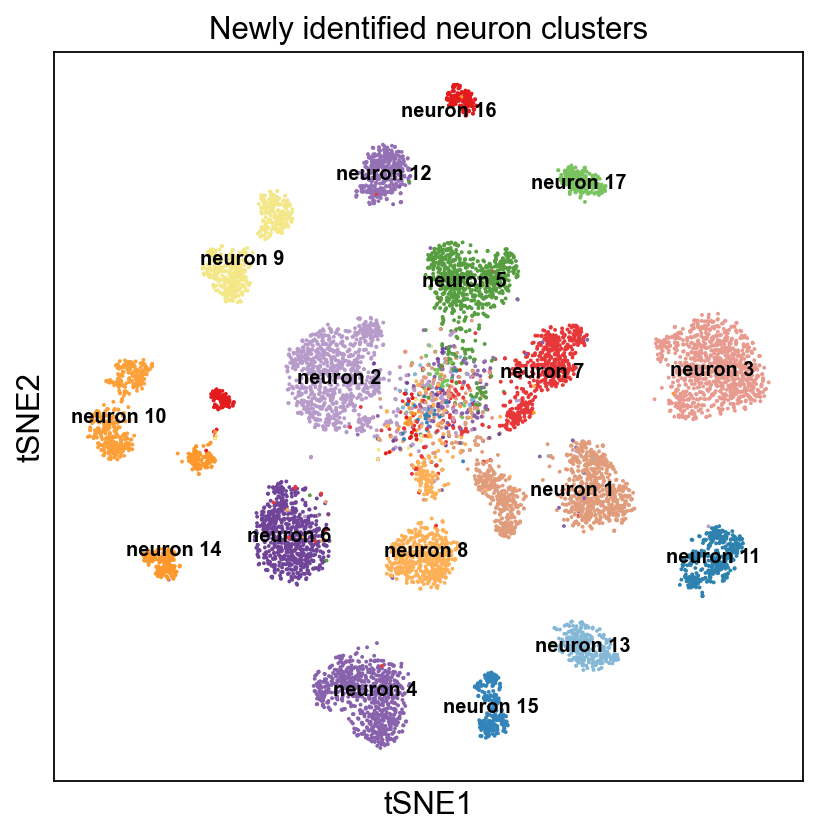

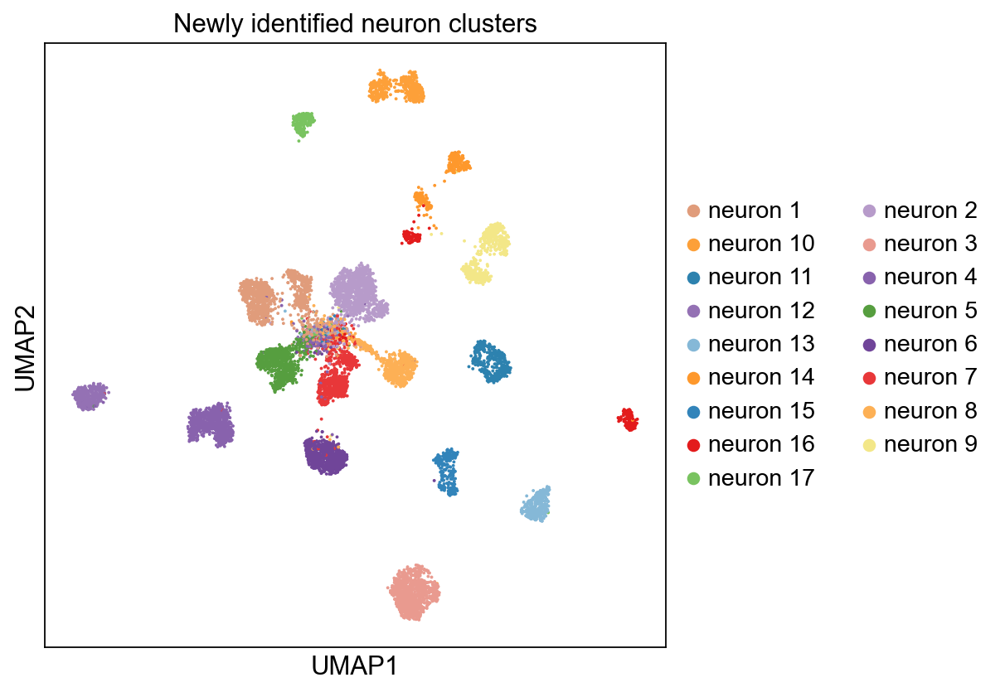

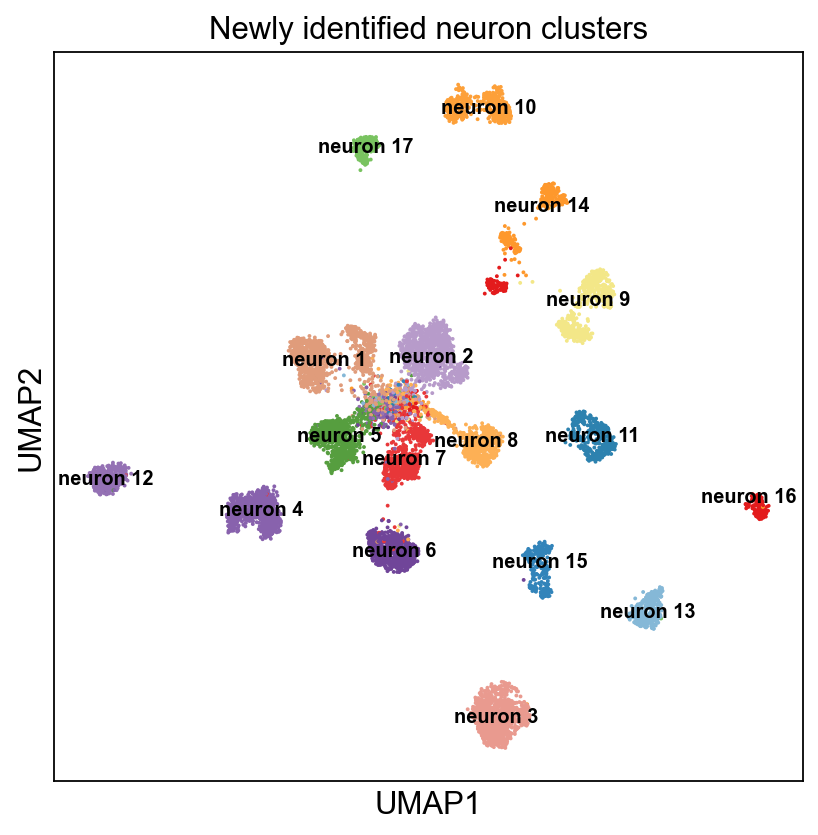

In [23]:
### Plot UMAP/tSNE
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_head_neuron, color=['leiden'], legend_loc='on data', save=f'_newNeuronClusters_subcluster_leiden_1.0.pdf')
    sc.pl.tsne(adata_head_neuron, color=['afca_annotation'], save=f'_newNeuronClusters_subcluster_afca_annotation.pdf',
               title='Newly identified neuron clusters')
    sc.pl.tsne(adata_head_neuron, color=['afca_annotation'], legend_loc='on data', legend_fontsize=9, save=f'_newNeuronClusters_subcluster_afca_annotation_legendOnData.pdf',
               title='Newly identified neuron clusters')
    sc.pl.umap(adata_head_neuron, color=['afca_annotation'], save=f'_newNeuronClusters_subcluster_afca_annotation.pdf',
               title='Newly identified neuron clusters')
    sc.pl.umap(adata_head_neuron, color=['afca_annotation'], legend_loc='on data', legend_fontsize=9, save=f'_newNeuronClusters_subcluster_afca_annotation_legendOnData.pdf',
               title='Newly identified neuron clusters')
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

In [17]:
numOnly_L=[x.split()[-1] for x in newNeuron_L]
numOnly_L

['1',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9']

In [24]:
neuronName_D=dict(zip(newNeuron_L, numOnly_L))
neuronName_D

{'neuron 1': '1',
 'neuron 10': '10',
 'neuron 11': '11',
 'neuron 12': '12',
 'neuron 13': '13',
 'neuron 14': '14',
 'neuron 15': '15',
 'neuron 16': '16',
 'neuron 17': '17',
 'neuron 2': '2',
 'neuron 3': '3',
 'neuron 4': '4',
 'neuron 5': '5',
 'neuron 6': '6',
 'neuron 7': '7',
 'neuron 8': '8',
 'neuron 9': '9'}

In [25]:
adata_head_neuron.obs['afca_annotation2'] = pd.Categorical([neuronName_D[annot] for annot in adata_head_neuron.obs.afca_annotation])

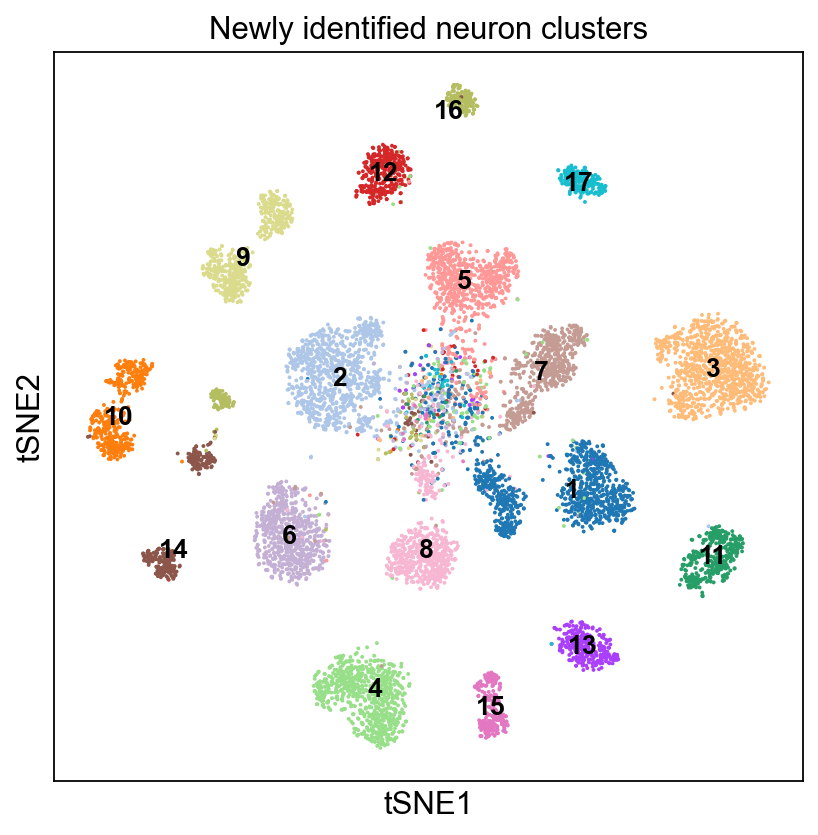

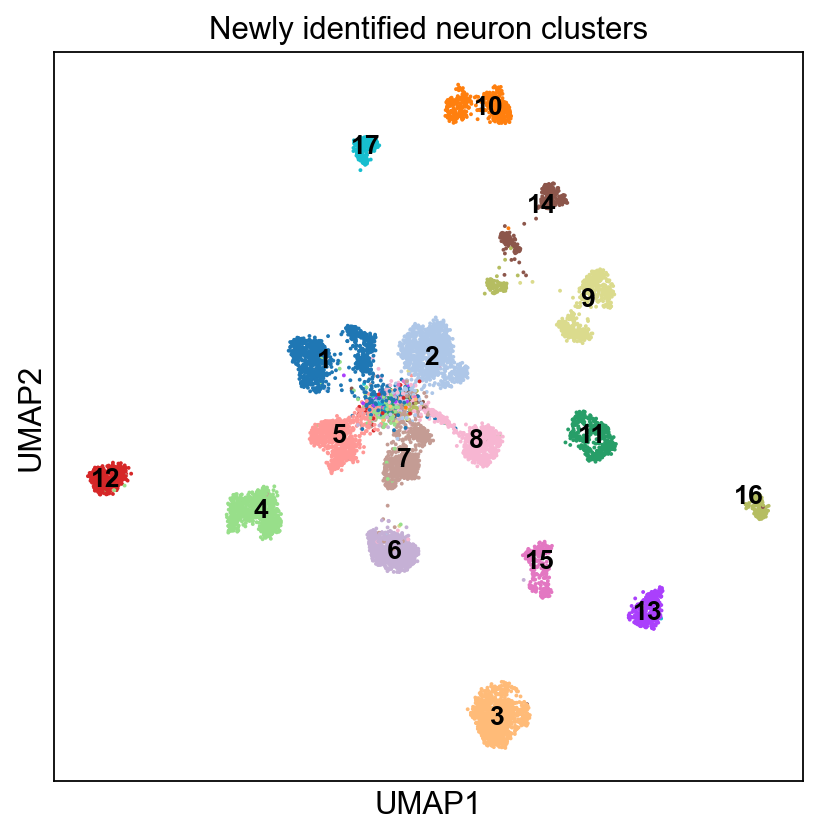

In [26]:
### Plot UMAP/tSNE
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_head_neuron, color=['afca_annotation2'], legend_loc='on data', legend_fontsize=12, save=f'_newNeuronClusters_subcluster_afca_annotation_legendOnData_numOnly.pdf',
               title='Newly identified neuron clusters')
    sc.pl.umap(adata_head_neuron, color=['afca_annotation2'], legend_loc='on data', legend_fontsize=12, save=f'_newNeuronClusters_subcluster_afca_annotation_legendOnData_numOnly.pdf',
               title='Newly identified neuron clusters')
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

In [32]:
adata_head_neuron.write(f'{figureFolder}/adata_head_newNeuron.h5ad')

In [18]:
adata_head_neuron=sc.read((f'{figureFolder}/adata_head_newNeuron.h5ad'))

# Figure 2C_sup: Markers of new neuron clusters

In [18]:
adata_head_neuron=sc.read((f'{figureFolder}/adata_head_newNeuron.h5ad'))

In [27]:
newNeuron_L = [f'neuron {x}' for x in range(1,18)]
newNeuron_L

['neuron 1',
 'neuron 2',
 'neuron 3',
 'neuron 4',
 'neuron 5',
 'neuron 6',
 'neuron 7',
 'neuron 8',
 'neuron 9',
 'neuron 10',
 'neuron 11',
 'neuron 12',
 'neuron 13',
 'neuron 14',
 'neuron 15',
 'neuron 16',
 'neuron 17']

In [28]:
markerGene_L=['CG34353', 'scro', 'eys', 'DIP-lambda', 'CG42346', 'pdm3', 'DIP-theta', 'beat-Ic', 'fred', 'SoxN', 'CG43902', 'Pvf3', 'fred', 'CG44422', 'CG34353', 'CG14989', 'bi', 'CG14989', 'CARPB',
  'CG43902', 'Lim1', 'DIP-beta', 'bru3', 'bi', 'bru3', 'Mp', 'CG14989', 'pdm3', 'Lim1', 'CG14989', 'DIP-lambda', 'Bx', 'bi', 'Syt1', 'para', 'VAChT', 'Gad1', 'VGlut']

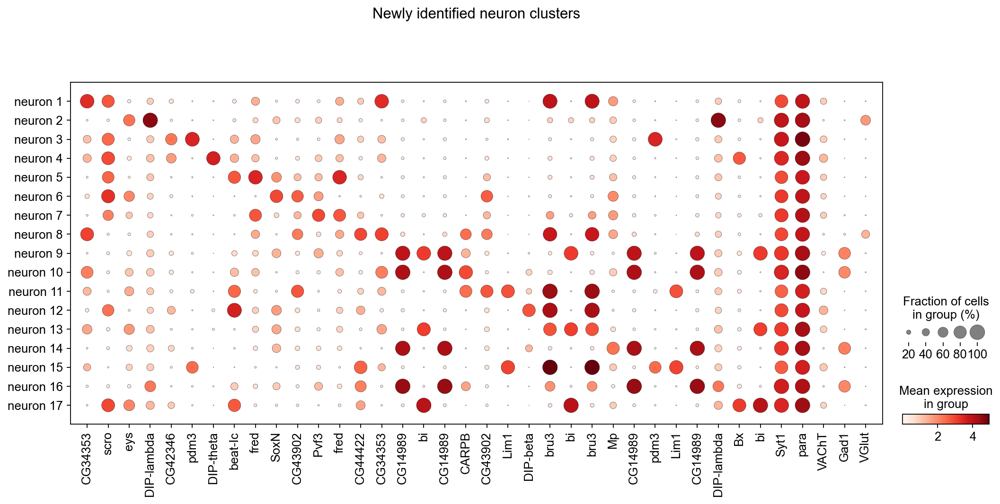

In [29]:
sc.pl.dotplot(adata_head_neuron, var_names=markerGene_L, groupby='afca_annotation', categories_order=newNeuron_L, save=f'_newNeuronMarkers_subcluster.pdf',
               title='Newly identified neuron clusters')
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

# Fig 2D

# Fig 2E Cell composition (compare to 5d)

In [16]:
adata_head=sc.read(f'{allHeadBodyDataFolder}/adata_head_S_v1.0.h5ad')
adata_body=sc.read(f'{allHeadBodyDataFolder}/adata_body_S_v1.0.h5ad')

In [17]:
adata_headBody=sc.read(f'{allHeadBodyDataFolder}/adata_headBody_S_v1.0.h5ad')

## Summarize cell#

In [18]:
celltypeAge_Df=adata_headBody.obs.groupby(by=['afca_annotation', 'age']).count()

In [20]:
celltypeN_Df=pd.DataFrame(columns=['annotation', 'cellN' ]+['cellN_' + age for age in age_L ])
for celltype in sorted(celltypeAge_Df.index.get_level_values('afca_annotation').categories):
    # print(celltype)
    
    celltypeCount_Df=celltypeAge_Df.loc[celltype]
    
    cellN=celltypeCount_Df.sex.sum()
    
    lowNumAge='N'
    # if cellN >=500:
        
    ageCellN_min=celltypeCount_Df.sex.min()
    # print(celltypeCount_Df.sex.min())
    # print(ageCellN_min)
    # print(celltypeCount_Df)


    ### Not filtered at the current stage (Use endoendocrine as an example)
    # if ageCellN_min < 100: 
    #     lowNumAge='Y'
    #     # print('ageCellN_min: ', celltypeCount_Df.sex.min())
    #     # print('lowNumAge: ', lowNumAge)

    if lowNumAge == 'N':
        # print(celltypeAge_Df.loc[celltype].loc[:,['sex']]) # .loc[:,['sex']]
        # print([celltype, cellN]+celltypeCount_Df.sex.to_list())
        celltypeN_Df.loc[celltype]=[celltype, cellN]+celltypeCount_Df.sex.to_list()
    # print()

In [22]:
celltypeN500_Df = celltypeN_Df[ (celltypeN_Df.cellN >= 500) & (celltypeN_Df.annotation != 'unannotated') ]

In [24]:
totalCellN_L = celltypeN_Df.iloc[:,2:].sum(axis=0).to_list()
totalCellN_L

[196905, 146304, 118795, 104250]

In [26]:
filtered_L = [x.strip() for x in open('Analysis/Figure/Figure3/agingFeature_cellTypeName_modified_selected.list')]

In [27]:
cellN_ratio_Df = pd.DataFrame(columns=['annotation', 'Included in aging feature', '5d_ratio', '30d_ratio', '50d_ratio', '70d_ratio'], index=celltypeN_Df.index.to_list())
for i, cellType in enumerate(cellN_ratio_Df.index):
    if cellType in filtered_L: agingFeature='Y'
    else: agingFeature='N'
    
    out_L = [cellType, agingFeature]
    for j, age in enumerate(age_L):
        ratio = float(celltypeN_Df.loc[cellType, f'cellN_{age}'])/float(totalCellN_L[j])
        out_L.append(ratio)
    cellN_ratio_Df.loc[cellType] = out_L

cellN_ratio_Df

,annotation,Included in aging feature,5d_ratio,30d_ratio,50d_ratio,70d_ratio
16-cell germline cyst in germarium region 2a and 2b,16-cell germline cyst in germarium region 2a a...,N,0.000462,0.00056,0.001077,0.002216
CNS surface associated glial cell,CNS surface associated glial cell,N,0.000254,0.000567,0.000404,0.000297
Johnston organ neuron,Johnston organ neuron,Y,0.002692,0.004108,0.006776,0.005247
Kenyon cell,Kenyon cell,N,0.00002,0.000021,0.000017,0.000019
Poxn neuron,Poxn neuron,N,0.000802,0.000964,0.001027,0.000959
...,...,...,...,...,...,...
transmedullary neuron Tm9,transmedullary neuron Tm9,N,0.002224,0.00136,0.00287,0.002062
unannotated,unannotated,N,0.208684,0.174855,0.231811,0.198427
visceral muscle of the crop,visceral muscle of the crop,N,0.002057,0.001388,0.000749,0.000643
visceral muscle of the midgut,visceral muscle of the midgut,Y,0.001508,0.00324,0.002172,0.002177


In [30]:
celltypeN_Df.to_csv(f'{cellnFolder}/celltype_cellN.csv', index=False)
celltypeN500_Df.to_csv(f'{cellnFolder}/celltype_cellN_n500.csv', index=False)

In [31]:
cellN_ratio_Df.to_csv(f'{cellnFolder}/celltype_cellN_ratio.csv', index=False)

---

## Head

In [32]:
celltypeN_Df=pd.read_csv(f'{cellnFolder}/celltype_cellN.csv')
celltypeN500_Df=pd.read_csv(f'{cellnFolder}/celltype_cellN_n500.csv')
celltypeN500_L = pd.read_csv(f'{cellnFolder}/celltype_cellN_n500.csv').annotation.to_list()
len(celltypeN500_L)

112

In [33]:
fcaTissue='head'

In [34]:
annotationDf=pd.DataFrame(adata_head.obs['afca_annotation'].value_counts())
d5annotationDf=pd.DataFrame(adata_head[adata_head.obs.age == '5'].obs[
    'afca_annotation'].value_counts())
d30annotationDf=pd.DataFrame(adata_head[adata_head.obs.age == '30'].obs[
    'afca_annotation'].value_counts())
d50annotationDf=pd.DataFrame(adata_head[adata_head.obs.age == '50'].obs[
    'afca_annotation'].value_counts())
d70annotationDf=pd.DataFrame(adata_head[adata_head.obs.age == '70'].obs[
    'afca_annotation'].value_counts())

annotationDf.columns=['TotalCell#']
d5annotationDf.columns=['5d_cell#']
d30annotationDf.columns=['30d_cell#']
d50annotationDf.columns=['50d_cell#']
d70annotationDf.columns=['70d_cell#']

annotationDf=pd.concat([annotationDf, d5annotationDf, d30annotationDf, d50annotationDf, d70annotationDf], axis =1)
annotationDf=annotationDf.sort_values(by=['5d_cell#'])
annotationDf


/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


,TotalCell#,5d_cell#,30d_cell#,50d_cell#,70d_cell#
Kenyon cell,11,4,3,2,2
lobula columnar neuron LC12,41,17,10,6,8
octopaminergic/tyraminergic neuron,94,38,18,24,14
ocellus retinula cell,283,57,87,105,34
neuron 17,233,69,42,74,48
...,...,...,...,...,...
olfactory receptor neuron,5415,1871,1189,1436,919
cone cell,17669,5100,3563,5180,3826
epithelial cell_head,14114,5522,1921,3504,3167
outer photoreceptor cell,21239,7202,6295,4087,3655


/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_90846/419042224.py:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


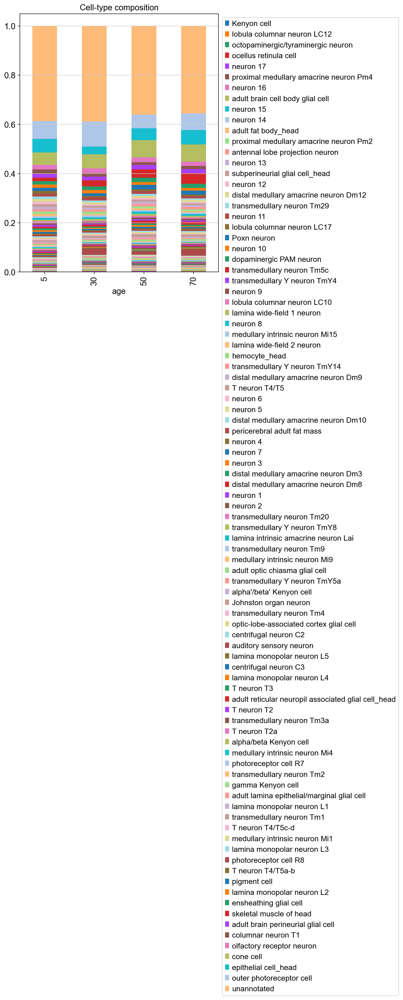

In [35]:
ratioDf=pd.DataFrame(index=annotationDf.index.to_list(), columns=['5d_ratio', '30d_ratio', '50d_ratio', '70d_ratio'])
for age in age_L:
    ratioDf[f'{age}d_ratio'] = ( annotationDf[f'{age}d_cell#']/sum(annotationDf[f'{age}d_cell#']) )
ratioDf = ratioDf.sort_values(by=['5d_ratio'])

ratioT_Df=ratioDf.transpose()
ratioT_Df.insert(0, 'age', age_L)

with rc_context({'figure.figsize': (6, 8)}): 
    ax=ratioT_Df.plot(
        x = 'age',
        kind = 'bar',
        stacked = True,
        title = 'Cell-type composition'
    )
    ax.grid(axis='x',visible=False)
    # plt.legend(loc='lower right')
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.tight_layout()
    plt.savefig(f'{figurePicFolder}/{fcaTissue}_barplot_degRatio.pdf')
    plt.show()


### Relative ratio (normalize to 5d)
Filter cell types with cellN <500

In [36]:
normalRatio_Df=ratioDf[:]
normalRatio_Df=normalRatio_Df.drop(['unannotated'], axis=0)
normalRatio_Df=normalRatio_Df[normalRatio_Df.index.isin(celltypeN500_L)]

In [37]:
for i in range(1,4):
    age=age_L[i]
    # print(age)    
    normalRatio_Df[f'{age}d/5d_ratio']=normalRatio_Df[f'{age}d_ratio']/normalRatio_Df[f'5d_ratio']

normalRatio_Df=normalRatio_Df.iloc[:,4:]
normalRatioNoLog2_Df=normalRatio_Df
normalRatio_Df=np.log2(normalRatio_Df)

normalRatioNoLog2_Df=normalRatioNoLog2_Df.sort_values(by='50d/5d_ratio', ascending=False)
normalRatio_Df=normalRatio_Df.sort_values(by='50d/5d_ratio', ascending=False)

In [38]:
normalRatio_Df.insert(0, 'annotation', normalRatio_Df.index.to_list())
normalRatio_longDf=normalRatio_Df.melt(id_vars=['annotation'], var_name='ageCompare', value_name='log2ratio')
normalRatio_longDf

,annotation,ageCompare,log2ratio
0,subperineurial glial cell_head,30d/5d_ratio,1.763267
1,pericerebral adult fat mass,30d/5d_ratio,3.084385
2,adult fat body_head,30d/5d_ratio,1.902973
3,adult brain cell body glial cell,30d/5d_ratio,2.750703
4,skeletal muscle of head,30d/5d_ratio,0.800541
...,...,...,...
208,lamina intrinsic amacrine neuron Lai,70d/5d_ratio,-0.719339
209,T neuron T4/T5a-b,70d/5d_ratio,-0.815831
210,T neuron T4/T5c-d,70d/5d_ratio,-0.971660
211,columnar neuron T1,70d/5d_ratio,-0.486967


In [39]:
dfAll=pd.concat([normalRatio_Df, 
           annotationDf.loc[normalRatio_Df.index.to_list(),:].drop(['TotalCell#', '5d_cell#'], axis=1)], 
          axis=1)
# dfAll

In [40]:
dotplot_Df=dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[1:4]), 
                      var_name='ageCompare', value_name='log2ratio')
# dotplot_Df

dotplot_Df=pd.concat([dotplot_Df, 
           dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[4:]), 
                      var_name='ageCompare', value_name='cellN').iloc[:,2] ], 
          axis=1) # 

In [41]:
normalRatio_Df.drop('annotation', axis=1, inplace=True)

/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_90846/2261792834.py:11: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_90846/2261792834.py:11: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_90846/2261792834.py:13: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.savefig(f'{figurePicFolder}/{fcaTissue}_dotplot_cellRatio_normalizeTo5d.pdf')
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/

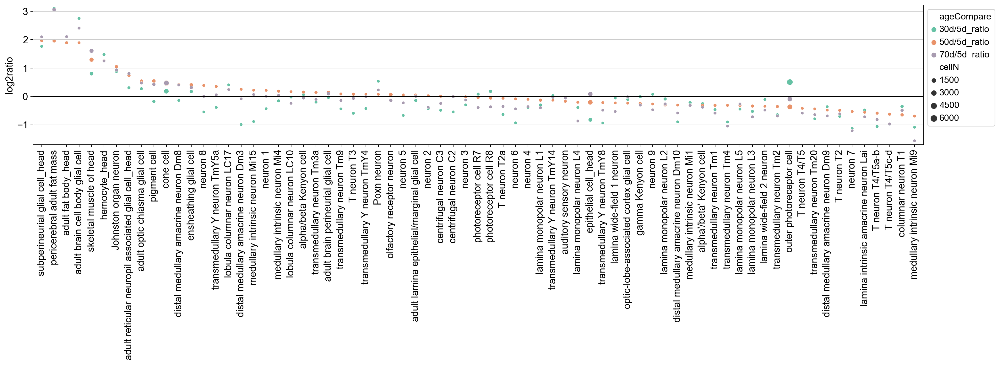

In [42]:
with rc_context({'figure.figsize': (20, 7.5)}):
    ax=sns.scatterplot(data=dotplot_Df, 
                       x="annotation", y="log2ratio", hue="ageCompare", size='cellN', palette=set2Color_L)
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.savefig(f'{figurePicFolder}/{fcaTissue}_dotplot_cellRatio_normalizeTo5d.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

In [43]:
annotationDf.to_csv(f'{cellnFolder}/{fcaTissue}_cellN.csv')

In [44]:
ratioDf.to_csv(f'{cellnFolder}/{fcaTissue}_ratioDf.csv')
dotplot_Df.to_csv(f'{cellnFolder}/{fcaTissue}_ratioDf_dotplot_Df.csv')

In [45]:
normalRatio_Df.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatioDf_normalizeTo5d.csv')
normalRatioNoLog2_Df.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatioNoLog2_Df_normalizeTo5d.csv')
normalRatio_longDf.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatio_longDf_normalizeTo5d.csv')

## Body

In [35]:
celltypeN_Df=pd.read_csv(f'{cellnFolder}/celltype_cellN.csv')
celltypeN500_Df=pd.read_csv(f'{cellnFolder}/celltype_cellN_n500.csv')
celltypeN500_L = pd.read_csv(f'{cellnFolder}/celltype_cellN_n500.csv').annotation.to_list()
len(celltypeN500_L)

112

In [18]:
fcaTissue='body'

In [19]:
annotationDf=pd.DataFrame(adata_body.obs['afca_annotation'].value_counts())
d5annotationDf=pd.DataFrame(adata_body[adata_body.obs.age == '5'].obs[
    'afca_annotation'].value_counts())
d30annotationDf=pd.DataFrame(adata_body[adata_body.obs.age == '30'].obs[
    'afca_annotation'].value_counts())
d50annotationDf=pd.DataFrame(adata_body[adata_body.obs.age == '50'].obs[
    'afca_annotation'].value_counts())
d70annotationDf=pd.DataFrame(adata_body[adata_body.obs.age == '70'].obs[
    'afca_annotation'].value_counts())

annotationDf.columns=['TotalCell#']
d5annotationDf.columns=['5d_cell#']
d30annotationDf.columns=['30d_cell#']
d50annotationDf.columns=['50d_cell#']
d70annotationDf.columns=['70d_cell#']

annotationDf=pd.concat([annotationDf, d5annotationDf, d30annotationDf, d50annotationDf, d70annotationDf], axis =1)
# annotationDf=annotationDf.sort_values(by=['5d_cell#'])
annotationDf


/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


,TotalCell#,5d_cell#,30d_cell#,50d_cell#,70d_cell#
16-cell germline cyst in germarium region 2a and 2b,532,91,82,128.0,231
CNS surface associated glial cell,212,50,83,48.0,31
adult Malpighian tubule principal cell,47,8,11,10.0,18
adult Malpighian tubule principal cell of initial segment,70,23,12,15.0,20
adult Malpighian tubule principal cell of lower segment,52,6,27,9.0,10
...,...,...,...,...,...
subperineurial glial cell_body,1451,333,445,279.0,394
unannotated,6250,2281,1584,1004.0,1381
visceral muscle of the crop,764,405,203,89.0,67
visceral muscle of the midgut,1256,297,474,258.0,227


In [31]:
annotationDf.fillna(0, inplace=True)

/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_65436/419042224.py:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


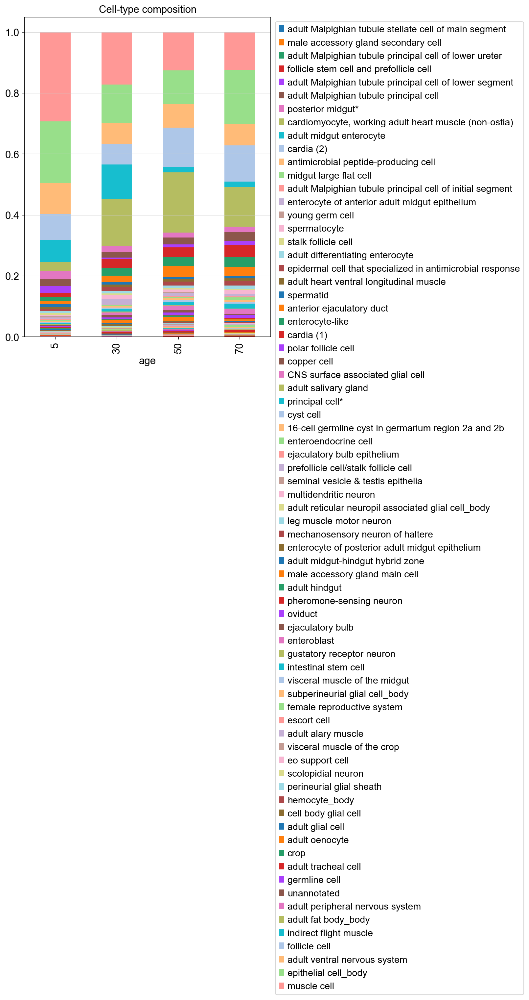

In [33]:
ratioDf=pd.DataFrame(index=annotationDf.index.to_list(), columns=['5d_ratio', '30d_ratio', '50d_ratio', '70d_ratio'])
for age in age_L:
    ratioDf[f'{age}d_ratio'] = ( annotationDf[f'{age}d_cell#']/sum(annotationDf[f'{age}d_cell#']) )
ratioDf = ratioDf.sort_values(by=['5d_ratio'])

ratioT_Df=ratioDf.transpose()
ratioT_Df.insert(0, 'age', age_L)

with rc_context({'figure.figsize': (6, 8)}): 
    ax=ratioT_Df.plot(
        x = 'age',
        kind = 'bar',
        stacked = True,
        title = 'Cell-type composition'
    )
    ax.grid(axis='x',visible=False)
    # plt.legend(loc='lower right')
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.tight_layout()
    plt.savefig(f'{figurePicFolder}/{fcaTissue}_barplot_degRatio.pdf')
    plt.show()


### Relative ratio (normalize to 5d)
Filter cell types with cellN <500

In [36]:
normalRatio_Df=ratioDf[:]
normalRatio_Df=normalRatio_Df.drop(['unannotated'], axis=0)
normalRatio_Df=normalRatio_Df[normalRatio_Df.index.isin(celltypeN500_L)]

In [37]:
for i in range(1,4):
    age=age_L[i]
    # print(age)    
    normalRatio_Df[f'{age}d/5d_ratio']=normalRatio_Df[f'{age}d_ratio']/normalRatio_Df[f'5d_ratio']

normalRatio_Df=normalRatio_Df.iloc[:,4:]
normalRatioNoLog2_Df=normalRatio_Df
normalRatio_Df=np.log2(normalRatio_Df)

normalRatioNoLog2_Df=normalRatioNoLog2_Df.sort_values(by='50d/5d_ratio', ascending=False)
normalRatio_Df=normalRatio_Df.sort_values(by='50d/5d_ratio', ascending=False)

In [38]:
normalRatio_Df.insert(0, 'annotation', normalRatio_Df.index.to_list())
normalRatio_longDf=normalRatio_Df.melt(id_vars=['annotation'], var_name='ageCompare', value_name='log2ratio')
normalRatio_longDf

,annotation,ageCompare,log2ratio
0,cardia (1),30d/5d_ratio,3.366614
1,adult fat body_body,30d/5d_ratio,2.441033
2,male accessory gland main cell,30d/5d_ratio,2.174354
3,enteroblast,30d/5d_ratio,1.664538
4,adult salivary gland,30d/5d_ratio,2.402504
...,...,...,...
118,visceral muscle of the crop,70d/5d_ratio,-1.644615
119,muscle cell,70d/5d_ratio,-1.249407
120,germline cell,70d/5d_ratio,-0.698137
121,adult reticular neuropil associated glial cell...,70d/5d_ratio,-0.445817


In [39]:
dfAll=pd.concat([normalRatio_Df, 
           annotationDf.loc[normalRatio_Df.index.to_list(),:].drop(['TotalCell#', '5d_cell#'], axis=1)], 
          axis=1)
# dfAll

In [40]:
dotplot_Df=dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[1:4]), 
                      var_name='ageCompare', value_name='log2ratio')
# dotplot_Df

dotplot_Df=pd.concat([dotplot_Df, 
           dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[4:]), 
                      var_name='ageCompare', value_name='cellN').iloc[:,2] ], 
          axis=1) # 

In [41]:
normalRatio_Df.drop('annotation', axis=1, inplace=True)

/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_65436/1199917375.py:11: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_65436/1199917375.py:11: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_65436/1199917375.py:13: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.savefig(f'{figurePicFolder}/{fcaTissue}_dotplot_cellRatio_normalizeTo5d.pdf')
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/

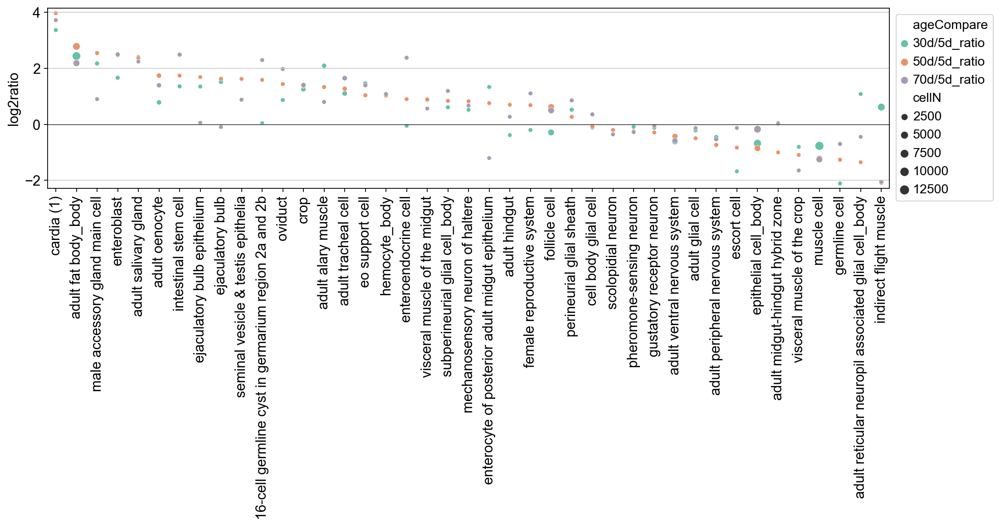

In [42]:
with rc_context({'figure.figsize': (14, 7.5)}):
    ax=sns.scatterplot(data=dotplot_Df, 
                       x="annotation", y="log2ratio", hue="ageCompare", size='cellN', palette=set2Color_L)
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.savefig(f'{figurePicFolder}/{fcaTissue}_dotplot_cellRatio_normalizeTo5d.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

In [43]:
ratioDf.to_csv(f'{cellnFolder}/{fcaTissue}_ratioDf.csv')
dotplot_Df.to_csv(f'{cellnFolder}/{fcaTissue}_ratioDf_dotplot_Df.csv')

In [44]:
normalRatio_Df.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatioDf_normalizeTo5d.csv')
normalRatioNoLog2_Df.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatioNoLog2_Df_normalizeTo5d.csv')
normalRatio_longDf.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatio_longDf_normalizeTo5d.csv')

## Combine body and head data: normalize to 5d

In [18]:
ratio_body_Df=pd.read_csv(f'{cellnFolder}/body_normalRatioDf_normalizeTo5d.csv')
ratio_head_Df=pd.read_csv(f'{cellnFolder}/head_normalRatioDf_normalizeTo5d.csv')

ratio_body_Df['tissue']='body'
ratio_head_Df['tissue']='head'

ratio_all_Df = pd.concat([ratio_body_Df, ratio_head_Df])
ratio_all_Df.columns=['annotation'] + ratio_all_Df.columns[1:].to_list()
ratio_all_Df=ratio_all_Df.reset_index()
ratio_all_Df.index=ratio_all_Df.annotation.to_list()
ratio_all_Df=ratio_all_Df.sort_values(by='50d/5d_ratio', ascending=False)

ratio_all_Df

,index,annotation,30d/5d_ratio,50d/5d_ratio,70d/5d_ratio,tissue
cardia (1),0,cardia (1),3.366614,3.970931,3.720461,body
adult fat body_body,1,adult fat body_body,2.441033,2.784070,2.185617,body
male accessory gland main cell,2,male accessory gland main cell,2.174354,2.545936,0.900669,body
enteroblast,3,enteroblast,1.664538,2.471348,2.500458,body
adult salivary gland,4,adult salivary gland,2.402504,2.364433,2.241751,body
...,...,...,...,...,...,...
visceral muscle of the crop,36,visceral muscle of the crop,-0.803392,-1.091072,-1.644615,body
muscle cell,37,muscle cell,-0.766909,-1.220535,-1.249407,body
germline cell,38,germline cell,-2.107656,-1.261042,-0.698137,body
adult reticular neuropil associated glial cell_body,39,adult reticular neuropil associated glial cell...,1.084027,-1.350827,-0.445817,body


In [19]:
ratio_all_mtx=ratio_all_Df.drop(['index', 'annotation'], axis=1)
ratio_all_mtx.to_csv(f'{cellnFolder}/headBody_cellN_log2Ratio.csv')
ratio_all_mtx=ratio_all_Df.drop(['index', 'annotation', 'tissue'], axis=1)

ratio_all_mtx

,30d/5d_ratio,50d/5d_ratio,70d/5d_ratio
cardia (1),3.366614,3.970931,3.720461
adult fat body_body,2.441033,2.784070,2.185617
male accessory gland main cell,2.174354,2.545936,0.900669
enteroblast,1.664538,2.471348,2.500458
adult salivary gland,2.402504,2.364433,2.241751
...,...,...,...
visceral muscle of the crop,-0.803392,-1.091072,-1.644615
muscle cell,-0.766909,-1.220535,-1.249407
germline cell,-2.107656,-1.261042,-0.698137
adult reticular neuropil associated glial cell_body,1.084027,-1.350827,-0.445817


In [20]:
ratio_all_Df.to_csv(f'{cellnFolder}/headBody_normalRatioDf_normalizeTo5d.csv')

In [21]:
dotplot_body_Df=pd.read_csv(f'{cellnFolder}/body_ratioDf_dotplot_Df.csv')
dotplot_head_Df=pd.read_csv(f'{cellnFolder}/head_ratioDf_dotplot_Df.csv')

dotplot_body_Df['tissue']='body'
dotplot_head_Df['tissue']='head'

In [22]:
dotplot_all_Df=pd.concat([dotplot_body_Df, dotplot_head_Df])
dotplot_all_Df=dotplot_all_Df.sort_values(by='log2ratio', ascending=False)
dotplot_all_Df.reset_index(inplace=True)
dotplot_all_Df

,index,Unnamed: 0,annotation,ageCompare,log2ratio,cellN,tissue
0,41,41,cardia (1),50d/5d_ratio,3.970931,323.0,body
1,82,82,cardia (1),70d/5d_ratio,3.720461,300.0,body
2,0,0,cardia (1),30d/5d_ratio,3.366614,397.0,body
3,1,1,pericerebral adult fat mass,30d/5d_ratio,3.084385,1594.0,head
4,143,143,pericerebral adult fat mass,70d/5d_ratio,3.057302,1374.0,head
...,...,...,...,...,...,...,...
331,118,118,visceral muscle of the crop,70d/5d_ratio,-1.644615,67.0,body
332,33,33,escort cell,30d/5d_ratio,-1.675038,103.0,body
333,122,122,indirect flight muscle,70d/5d_ratio,-2.050574,875.0,body
334,81,81,indirect flight muscle,50d/5d_ratio,-2.085490,773.0,body


In [23]:
dotplot_Order=dotplot_all_Df[
    dotplot_all_Df.ageCompare == '50d/5d_ratio'].sort_values(by='log2ratio', ascending=False).annotation.to_list()
# dotplot_Order

In [24]:
dotplot_TissueOrder_Df=pd.DataFrame(dotplot_all_Df[
    dotplot_all_Df.ageCompare == '50d/5d_ratio'].sort_values(by='log2ratio', ascending=False).tissue.to_list(),
                                   index=dotplot_Order, columns=['tissue'])

In [25]:
dotplot_allNew_Df=pd.DataFrame(columns=dotplot_all_Df.columns.to_list())
for annotOrder in dotplot_Order:
    dotplot_allNew_Df=pd.concat([dotplot_allNew_Df, 
                                 dotplot_all_Df[dotplot_all_Df.annotation == annotOrder]])
dotplot_allNew_Df.reset_index(inplace=True)
dotplot_allNew_Df=dotplot_allNew_Df.iloc[:, 3:]
dotplot_allNew_Df['annotation']=pd.Categorical(dotplot_allNew_Df['annotation'], ordered=True, 
                                               categories=dotplot_Order)
dotplot_allNew_Df['ageCompare']=pd.Categorical(dotplot_allNew_Df['ageCompare'], ordered=True, 
                                               categories=['30d/5d_ratio', '50d/5d_ratio', '70d/5d_ratio'])

dotplot_allNew_Df

,annotation,ageCompare,log2ratio,cellN,tissue
0,cardia (1),50d/5d_ratio,3.970931,323.0,body
1,cardia (1),70d/5d_ratio,3.720461,300.0,body
2,cardia (1),30d/5d_ratio,3.366614,397.0,body
3,adult fat body_body,50d/5d_ratio,2.784070,8932.0,body
4,adult fat body_body,30d/5d_ratio,2.441033,13158.0,body
...,...,...,...,...,...
331,adult reticular neuropil associated glial cell...,70d/5d_ratio,-0.445817,60.0,body
332,adult reticular neuropil associated glial cell...,50d/5d_ratio,-1.350827,29.0,body
333,indirect flight muscle,30d/5d_ratio,0.616862,9401.0,body
334,indirect flight muscle,70d/5d_ratio,-2.050574,875.0,body


In [28]:
dotplot_allNew_Df.to_csv(f'{compositionFolder}/dotplot_all_Df_compareTo5d.csv', index=False)

/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_65436/3080356730.py:13: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_65436/3080356730.py:13: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_65436/3080356730.py:14: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.savefig(f'{figurePicFolder}/headBody_dotplot_cellRatio_normalizeTo5d_mainFigure.pdf')
/var/folders/jj/t95qp6v1343877pd7n071t200

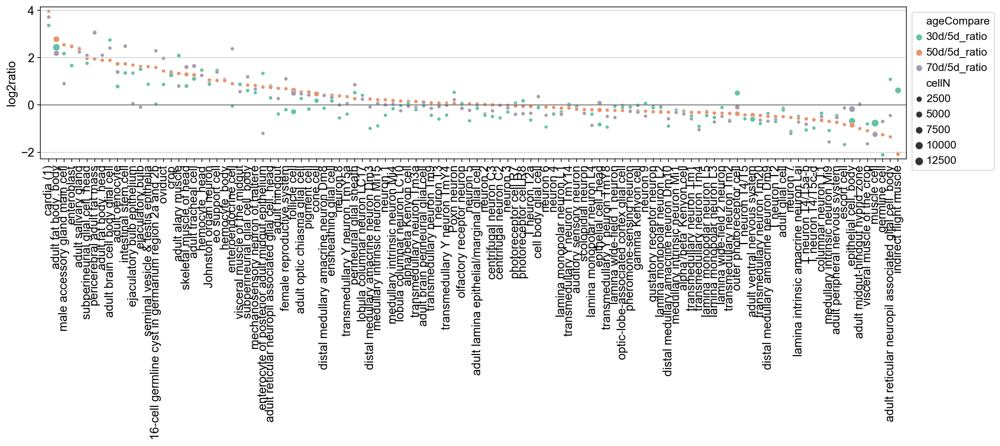

In [54]:
with rc_context({'figure.figsize': (16.5, 7.5)}):
    ax=sns.scatterplot(data=dotplot_allNew_Df, 
                       x="annotation", y="log2ratio", hue="ageCompare", size='cellN', palette=set2Color_L) # "#F1BB7B", "#FD6467", "#5B1A18"
    ax.margins(0.01, 0.03)
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    # plt.legend(['30d/5d_ratio', '50d/5d_ratio', '70d/5d_ratio'])
    plt.tight_layout()
    plt.savefig(f'{figurePicFolder}/headBody_dotplot_cellRatio_normalizeTo5d_mainFigure.pdf')
    plt.show()

/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_65436/1183341194.py:13: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_65436/1183341194.py:13: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_65436/1183341194.py:14: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.savefig(f'{figurePicFolder}/headBody_dotplot_cellRatio_normalizeTo5d.pdf')
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipy

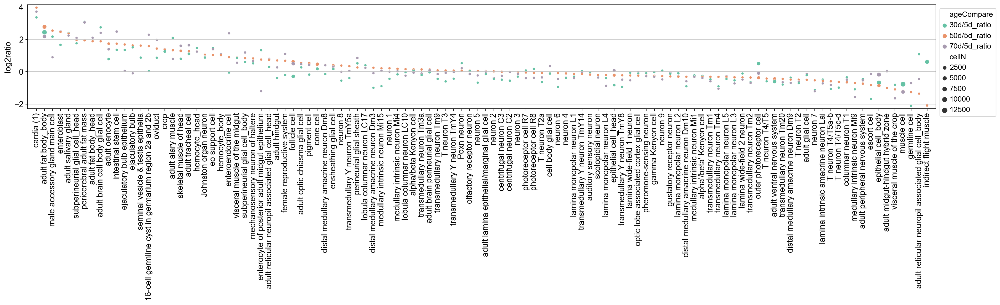

In [56]:
with rc_context({'figure.figsize': (24, 7.5)}):
    ax=sns.scatterplot(data=dotplot_allNew_Df, 
                       x="annotation", y="log2ratio", hue="ageCompare", size='cellN', palette=set2Color_L) # "#F1BB7B", "#FD6467", "#5B1A18"
    ax.margins(0.01, 0.03)
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    # plt.legend(['30d/5d_ratio', '50d/5d_ratio', '70d/5d_ratio'])
    plt.tight_layout()
    plt.savefig(f'{figurePicFolder}/headBody_dotplot_cellRatio_normalizeTo5d.pdf')
    plt.show()

In [57]:
df=pd.DataFrame(ratio_all_Df.tissue).T

In [58]:
value_to_int={'body':0, 'head': 1}
# value_to_int
n = len(value_to_int)    
cmap=sns.color_palette("Set3", 8) # Pastel2
cmap

[(0.5529411764705883, 0.8274509803921568, 0.7803921568627451),
 (1.0, 1.0, 0.7019607843137254),
 (0.7450980392156863, 0.7294117647058823, 0.8549019607843137),
 (0.984313725490196, 0.5019607843137255, 0.4470588235294118),
 (0.5019607843137255, 0.6941176470588235, 0.8274509803921568),
 (0.9921568627450981, 0.7058823529411765, 0.3843137254901961),
 (0.7019607843137254, 0.8705882352941177, 0.4117647058823529),
 (0.9882352941176471, 0.803921568627451, 0.8980392156862745)]

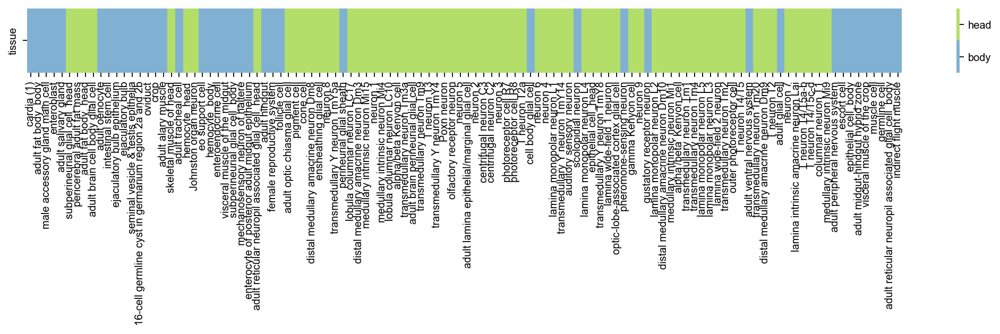

In [59]:
plt.figure(figsize=(16.5, 1))
parameters = {'xtick.labelsize': 9,'ytick.labelsize': 9, 'legend.fontsize':9}
plt.rcParams.update(parameters)

ax = sns.heatmap(df.replace(value_to_int), cmap=[cmap[4], cmap[6]], xticklabels=True ) # [cmap[4], cmap[6]]
colorbar=ax.collections[0].colorbar
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n * (0.5 + i) for i in range(n)])
colorbar.set_ticklabels(value_to_int.keys()) #not in the right order # sorted(list(value_to_int.keys()))
# colorbar.set_ticklabels(['head', 'body'])
# plt.xlabel('', fontsize=20)
# ax.xaxis.label.set_size(50)
# plt.tight_layout()
plt.savefig(f'{figurePicFolder}/headBody_barplot_cellRatio_tissue_mainFigure.pdf')

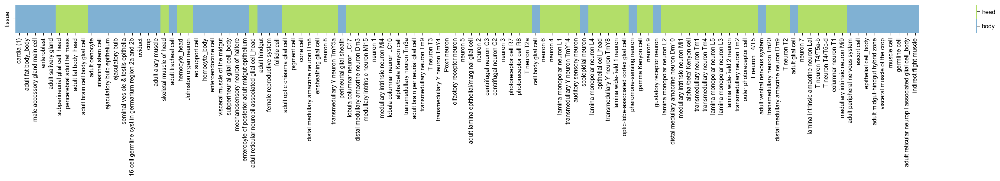

In [60]:
# with rc_context({'figure.figsize': (40, 7)}):
plt.figure(figsize=(24, 4))
parameters = {'xtick.labelsize': 9,'ytick.labelsize': 9, 'legend.fontsize':9}
plt.rcParams.update(parameters)

ax = sns.heatmap(df.replace(value_to_int), cmap=[cmap[4], cmap[6]], xticklabels=True )
colorbar=ax.collections[0].colorbar
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n * (0.5 + i) for i in range(n)])
colorbar.set_ticklabels(value_to_int.keys()) #not in the right order
# colorbar.set_ticklabels(['head', 'body'])
# plt.xlabel('', fontsize=20)
# ax.xaxis.label.set_size(50)
plt.tight_layout()
plt.savefig(f'{figurePicFolder}/headBody_barplot_cellRatio_tissue.pdf')

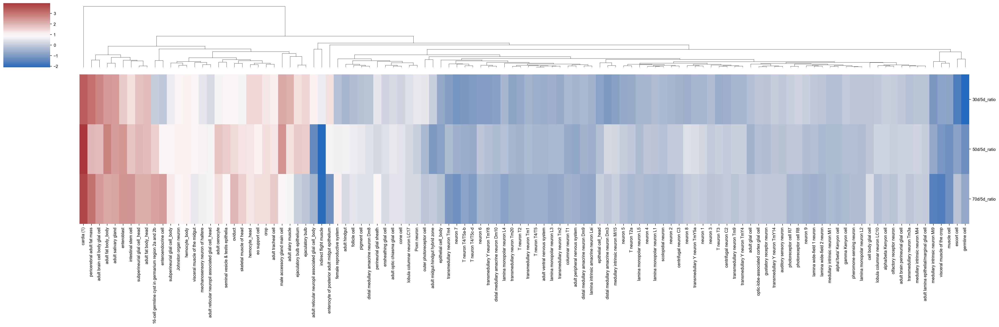

In [61]:
with rc_context({'figure.figsize': (10, 5)}): 
    ax=sns.clustermap(ratio_all_mtx.transpose(), xticklabels=True,  dendrogram_ratio=(0.05, 0.3), figsize=(30, 10), row_cluster=False, cmap="vlag") # standard_scale=0,  , cbar_pos=(.01, .25, .05, 0.2)
    plt.setp(ax.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
    # ax.ax.margins(0.01, 0.03)
    plt.tight_layout()
    plt.savefig(f'{figurePicFolder}/headBody_heatmap_cellRatio_normalizeTo5d.pdf')

In [62]:
ratio_all_mtx_select=\
    ratio_all_mtx[(abs(ratio_all_mtx['30d/5d_ratio']) >= 1) | 
              (abs(ratio_all_mtx['50d/5d_ratio']) >= 1)| 
              (abs(ratio_all_mtx['70d/5d_ratio']) >= 1) ]

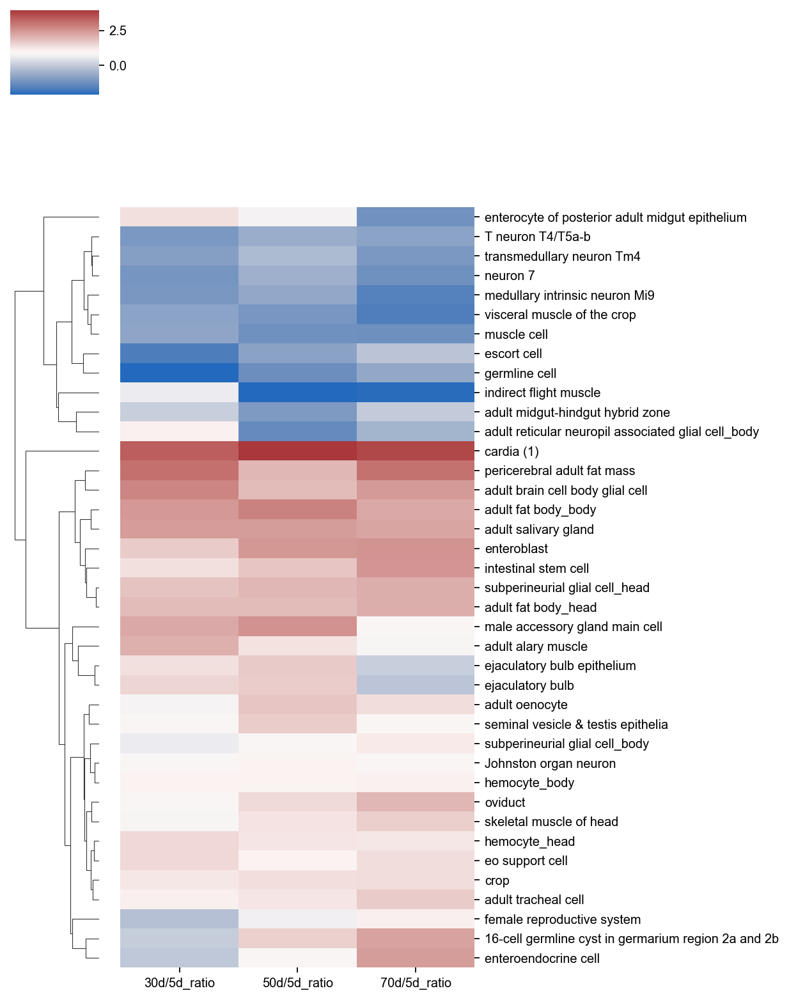

In [63]:
with rc_context({'figure.figsize': (10, 5)}): 
    ax=sns.clustermap(ratio_all_mtx_select, figsize=(8, 10), yticklabels=True, dendrogram_ratio=(0.2, 0.1), col_cluster=False, cmap="vlag") # standard_scale=1, 
    # ax.ax_row_dendrogram.set_visible(False)
    plt.tight_layout()
    plt.savefig(f'{figurePicFolder}/headBody_heatmap_cellRatio_normalizeTo5d_fc1.pdf')

In [64]:
ratio_all_mtx_select=\
    ratio_all_mtx[(abs(ratio_all_mtx['30d/5d_ratio']) >= 1.5) | 
              (abs(ratio_all_mtx['50d/5d_ratio']) >= 1.5)| 
              (abs(ratio_all_mtx['70d/5d_ratio']) >= 1.5) ]

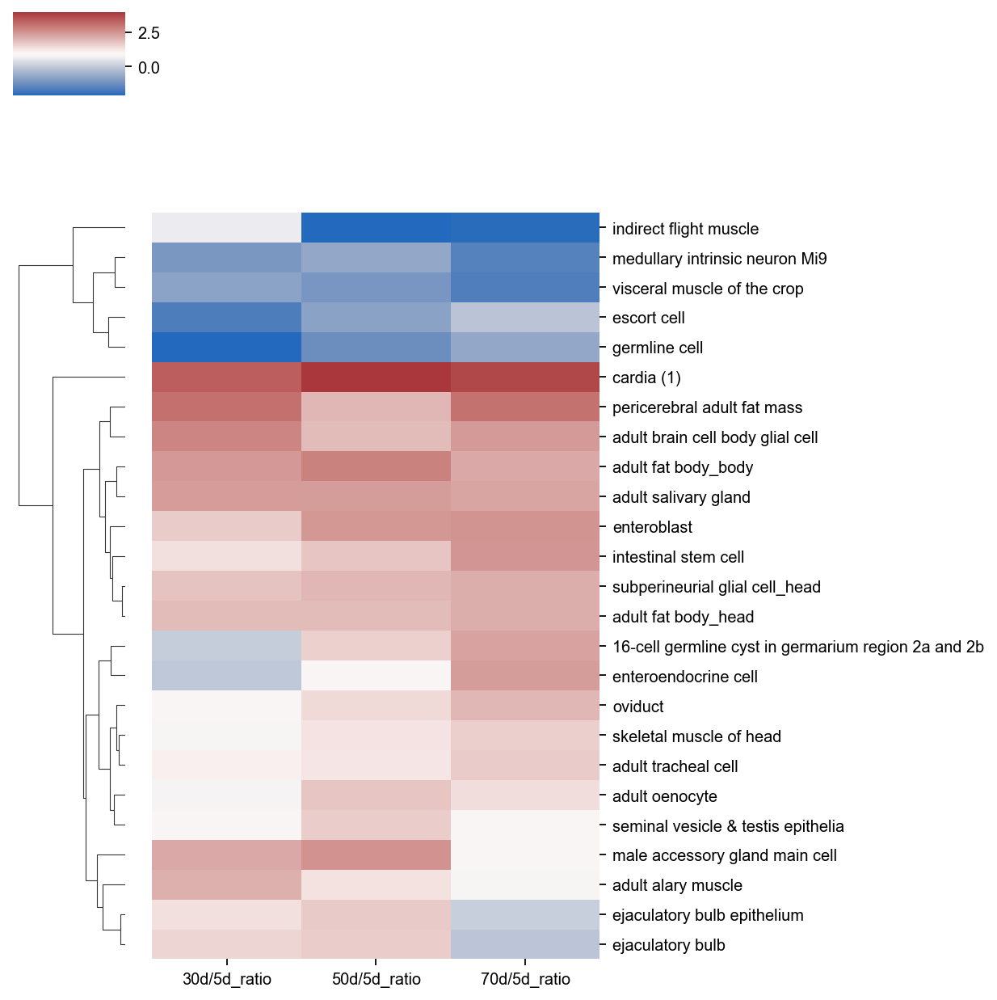

In [65]:
with rc_context({'figure.figsize': (10, 5)}): 
    ax=sns.clustermap(ratio_all_mtx_select, figsize=(8, 8), yticklabels=True, dendrogram_ratio=(0.2, 0.1), col_cluster=False, cmap="vlag") # standard_scale=1, 
    # ax.ax_row_dendrogram.set_visible(False)
    plt.tight_layout()
    plt.savefig(f'{figurePicFolder}/headBody_heatmap_cellRatio_normalizeTo5d_fc1.5.pdf')

# Sup: Cell composition (compare two consecutive ages)

In [13]:
adata_head=sc.read(f'{allHeadBodyDataFolder}/adata_head_S_v1.0.h5ad')
adata_body=sc.read(f'{allHeadBodyDataFolder}/adata_body_S_v1.0.h5ad')

In [14]:
adata_headBody=sc.read(f'{allHeadBodyDataFolder}/adata_headBody_S_v1.0.h5ad')

## Summarize cell#

In [15]:
celltypeAge_Df=adata_headBody.obs.groupby(by=['afca_annotation', 'age']).count()

In [16]:
celltypeN_Df=pd.DataFrame(columns=['annotation', 'cellN' ]+['cellN_' + age for age in age_L ])
for celltype in sorted(celltypeAge_Df.index.get_level_values('afca_annotation').categories):
    # print(celltype)
    
    celltypeCount_Df=celltypeAge_Df.loc[celltype]
    
    cellN=celltypeCount_Df.sex.sum()
    
    lowNumAge='N'
    # if cellN >=500:
        
    ageCellN_min=celltypeCount_Df.sex.min()
    # print(celltypeCount_Df.sex.min())
    # print(ageCellN_min)
    # print(celltypeCount_Df)


    ### Not filtered at the current stage (Use endoendocrine as an example)
    # if ageCellN_min < 100: 
    #     lowNumAge='Y'
    #     # print('ageCellN_min: ', celltypeCount_Df.sex.min())
    #     # print('lowNumAge: ', lowNumAge)

    if lowNumAge == 'N':
        # print(celltypeAge_Df.loc[celltype].loc[:,['sex']]) # .loc[:,['sex']]
        # print([celltype, cellN]+celltypeCount_Df.sex.to_list())
        celltypeN_Df.loc[celltype]=[celltype, cellN]+celltypeCount_Df.sex.to_list()
    # print()

In [17]:
celltypeN500_Df = celltypeN_Df[ (celltypeN_Df.cellN >= 500) & (celltypeN_Df.annotation != 'unannotated') ]

In [18]:
celltypeN500_Df

,annotation,cellN,cellN_5,cellN_30,cellN_50,cellN_70
16-cell germline cyst in germarium region 2a and 2b,16-cell germline cyst in germarium region 2a a...,532,91,82,128,231
Johnston organ neuron,Johnston organ neuron,2483,530,601,805,547
Poxn neuron,Poxn neuron,521,158,141,122,100
T neuron T2,T neuron T2,1596,708,268,370,250
T neuron T2a,T neuron T2a,1801,714,283,501,303
...,...,...,...,...,...,...
transmedullary neuron Tm3a,transmedullary neuron Tm3a,2019,708,380,574,357
transmedullary neuron Tm4,transmedullary neuron Tm4,1158,531,175,313,139
transmedullary neuron Tm9,transmedullary neuron Tm9,1193,438,199,341,215
visceral muscle of the crop,visceral muscle of the crop,764,405,203,89,67


In [19]:
celltypeN_Df.to_csv(f'{cellnFolder}/celltype_cellN.csv', index=False)
celltypeN500_Df.to_csv(f'{cellnFolder}/celltype_cellN_n500.csv', index=False)

## Head

In [20]:
celltypeN_Df=pd.read_csv(f'{cellnFolder}/celltype_cellN.csv')
celltypeN500_Df=pd.read_csv(f'{cellnFolder}/celltype_cellN_n500.csv')
celltypeN500_L = pd.read_csv(f'{cellnFolder}/celltype_cellN_n500.csv').annotation.to_list()
len(celltypeN500_L)

112

In [21]:
fcaTissue='head'

In [22]:
annotationDf=pd.DataFrame(adata_head.obs['afca_annotation'].value_counts())
d5annotationDf=pd.DataFrame(adata_head[adata_head.obs.age == '5'].obs[
    'afca_annotation'].value_counts())
d30annotationDf=pd.DataFrame(adata_head[adata_head.obs.age == '30'].obs[
    'afca_annotation'].value_counts())
d50annotationDf=pd.DataFrame(adata_head[adata_head.obs.age == '50'].obs[
    'afca_annotation'].value_counts())
d70annotationDf=pd.DataFrame(adata_head[adata_head.obs.age == '70'].obs[
    'afca_annotation'].value_counts())

annotationDf.columns=['TotalCell#']
d5annotationDf.columns=['5d_cell#']
d30annotationDf.columns=['30d_cell#']
d50annotationDf.columns=['50d_cell#']
d70annotationDf.columns=['70d_cell#']

annotationDf=pd.concat([annotationDf, d5annotationDf, d30annotationDf, d50annotationDf, d70annotationDf], axis =1)
annotationDf=annotationDf.sort_values(by=['5d_cell#'])
annotationDf


/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


,TotalCell#,5d_cell#,30d_cell#,50d_cell#,70d_cell#
Kenyon cell,11,4,3,2,2
lobula columnar neuron LC12,41,17,10,6,8
octopaminergic/tyraminergic neuron,94,38,18,24,14
ocellus retinula cell,283,57,87,105,34
neuron 17,233,69,42,74,48
...,...,...,...,...,...
olfactory receptor neuron,5415,1871,1189,1436,919
cone cell,17669,5100,3563,5180,3826
epithelial cell_head,14114,5522,1921,3504,3167
outer photoreceptor cell,21239,7202,6295,4087,3655


/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_5208/291502626.py:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


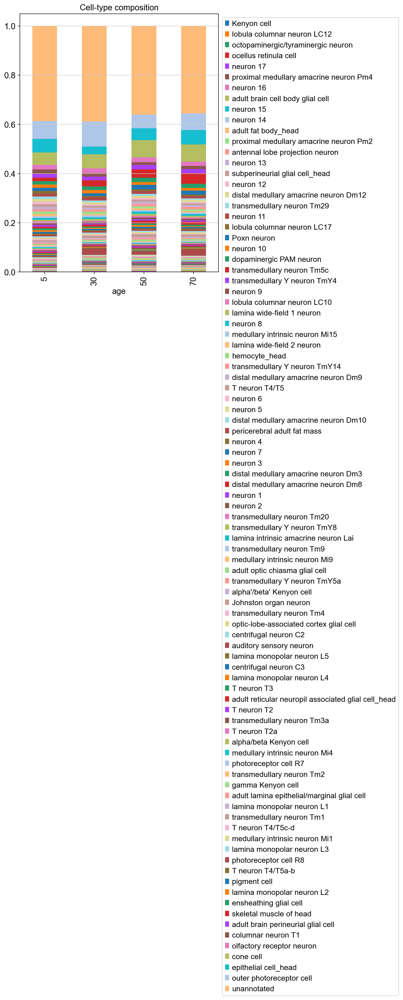

In [24]:
ratioDf=pd.DataFrame(index=annotationDf.index.to_list(), columns=['5d_ratio', '30d_ratio', '50d_ratio', '70d_ratio'])
for age in age_L:
    ratioDf[f'{age}d_ratio'] = ( annotationDf[f'{age}d_cell#']/sum(annotationDf[f'{age}d_cell#']) )
ratioDf = ratioDf.sort_values(by=['5d_ratio'])

ratioT_Df=ratioDf.transpose()
ratioT_Df.insert(0, 'age', age_L)

with rc_context({'figure.figsize': (6, 8)}): 
    ax=ratioT_Df.plot(
        x = 'age',
        kind = 'bar',
        stacked = True,
        title = 'Cell-type composition'
    )
    ax.grid(axis='x',visible=False)
    # plt.legend(loc='lower right')
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.tight_layout()
    plt.savefig(f'{figurePicFolder}/{fcaTissue}_barplot_degRatio_normalizeInterval.pdf')
    plt.show()


### Relative ratio (normalize to previous time point)
Filter cell types with cellN <500

In [25]:
celltypeN_Df

,annotation,cellN,cellN_5,cellN_30,cellN_50,cellN_70
0,16-cell germline cyst in germarium region 2a a...,532,91,82,128,231
1,CNS surface associated glial cell,212,50,83,48,31
2,Johnston organ neuron,2483,530,601,805,547
3,Kenyon cell,11,4,3,2,2
4,Poxn neuron,521,158,141,122,100
...,...,...,...,...,...,...
158,transmedullary neuron Tm9,1193,438,199,341,215
159,unannotated,114897,41091,25582,27538,20686
160,visceral muscle of the crop,764,405,203,89,67
161,visceral muscle of the midgut,1256,297,474,258,227


In [26]:
normalRatio_Df=ratioDf[:]
normalRatio_Df=normalRatio_Df.drop(['unannotated'], axis=0)
normalRatio_Df=normalRatio_Df[normalRatio_Df.index.isin(celltypeN_Df.annotation.to_list())]

In [27]:
for i in range(3):
    age=age_L[i]
    age2=age_L[i+1]
    # print(age)    
    normalRatio_Df[f'{age2}d/{age}d_ratio']=normalRatio_Df[f'{age2}d_ratio']/normalRatio_Df[f'{age}d_ratio']

normalRatio_Df=normalRatio_Df.iloc[:,4:]
normalRatioNoLog2_Df=normalRatio_Df
normalRatio_Df=np.log2(normalRatio_Df)

normalRatioNoLog2_Df=normalRatioNoLog2_Df.sort_values(by='30d/5d_ratio', ascending=False)
normalRatio_Df=normalRatio_Df.sort_values(by='30d/5d_ratio', ascending=False)

In [28]:
normalRatio_Df.insert(0, 'annotation', normalRatio_Df.index.to_list())
normalRatio_longDf=normalRatio_Df.melt(id_vars=['annotation'], var_name='ageCompare', value_name='log2ratio')
normalRatio_longDf

,annotation,ageCompare,log2ratio
0,pericerebral adult fat mass,30d/5d_ratio,3.084385
1,adult brain cell body glial cell,30d/5d_ratio,2.750703
2,adult fat body_head,30d/5d_ratio,1.902973
3,subperineurial glial cell_head,30d/5d_ratio,1.763267
4,hemocyte_head,30d/5d_ratio,1.475143
...,...,...,...
265,T neuron T4/T5c-d,70d/50d_ratio,-0.344851
266,distal medullary amacrine neuron Dm3,70d/50d_ratio,-0.337670
267,T neuron T4/T5a-b,70d/50d_ratio,-0.226803
268,medullary intrinsic neuron Mi9,70d/50d_ratio,-0.869175


In [29]:
dfAll=pd.concat([normalRatio_Df, 
           annotationDf.loc[normalRatio_Df.index.to_list(),:].drop(['TotalCell#', '5d_cell#'], axis=1)], 
          axis=1)
# dfAll

In [30]:
dotplot_Df=dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[1:4]), 
                      var_name='ageCompare', value_name='log2ratio')
# dotplot_Df

dotplot_Df=pd.concat([dotplot_Df, 
           dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[4:]), 
                      var_name='ageCompare', value_name='cellN').iloc[:,2] ], 
          axis=1) # 

In [31]:
normalRatio_Df.drop('annotation', axis=1, inplace=True)

/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_5208/159028905.py:11: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_5208/159028905.py:11: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_5208/159028905.py:13: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.savefig(f'{figurePicFolder}/{fcaTissue}_dotplot_cellRatio_normalizeInterval.pdf')
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ip

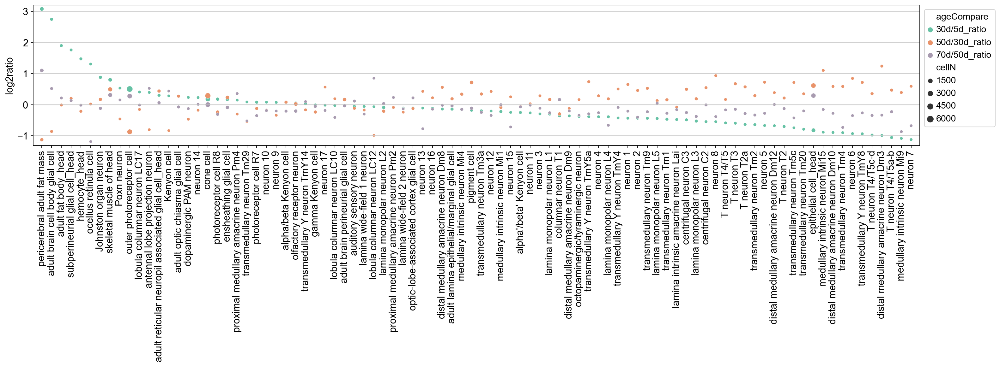

In [32]:
with rc_context({'figure.figsize': (20, 7.5)}):
    ax=sns.scatterplot(data=dotplot_Df, 
                       x="annotation", y="log2ratio", hue="ageCompare", size='cellN', palette=set2Color_L)
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.savefig(f'{figurePicFolder}/{fcaTissue}_dotplot_cellRatio_normalizeInterval.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

In [33]:
annotationDf.to_csv(f'{cellnFolder}/{fcaTissue}_cellN_normalizeInterval.csv')

In [34]:
ratioDf.to_csv(f'{cellnFolder}/{fcaTissue}_ratioDf_normalizeInterval.csv')
dotplot_Df.to_csv(f'{cellnFolder}/{fcaTissue}_ratioDf_dotplot_Df_normalizeInterval.csv')

In [35]:
normalRatio_Df.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatioDf_normalizeInterval.csv')
normalRatioNoLog2_Df.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatioNoLog2_Df_normalizeInterval.csv')
normalRatio_longDf.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatio_longDf_normalizeInterval.csv')

## Body

In [36]:
fcaTissue='body'

In [37]:
annotationDf=pd.DataFrame(adata_body.obs['afca_annotation'].value_counts())
d5annotationDf=pd.DataFrame(adata_body[adata_body.obs.age == '5'].obs[
    'afca_annotation'].value_counts())
d30annotationDf=pd.DataFrame(adata_body[adata_body.obs.age == '30'].obs[
    'afca_annotation'].value_counts())
d50annotationDf=pd.DataFrame(adata_body[adata_body.obs.age == '50'].obs[
    'afca_annotation'].value_counts())
d70annotationDf=pd.DataFrame(adata_body[adata_body.obs.age == '70'].obs[
    'afca_annotation'].value_counts())

annotationDf.columns=['TotalCell#']
d5annotationDf.columns=['5d_cell#']
d30annotationDf.columns=['30d_cell#']
d50annotationDf.columns=['50d_cell#']
d70annotationDf.columns=['70d_cell#']

annotationDf=pd.concat([annotationDf, d5annotationDf, d30annotationDf, d50annotationDf, d70annotationDf], axis =1)
annotationDf=annotationDf.sort_values(by=['5d_cell#'])
annotationDf


/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


,TotalCell#,5d_cell#,30d_cell#,50d_cell#,70d_cell#
adult Malpighian tubule stellate cell of main segment,10,2,2,2.0,4
male accessory gland secondary cell,20,2,2,8.0,8
adult Malpighian tubule principal cell of lower ureter,35,4,23,6.0,2
follicle stem cell and prefollicle cell,430,5,94,124.0,207
adult Malpighian tubule principal cell of lower segment,52,6,27,9.0,10
...,...,...,...,...,...
indirect flight muscle,18057,7008,9401,773.0,875
follicle cell,25738,8122,5826,5853.0,5937
adult ventral nervous system,22631,9977,5728,3472.0,3454
epithelial cell_body,44094,19479,10646,5034.0,8935


In [38]:
annotationDf.fillna(0, inplace=True)

/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_5208/291502626.py:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


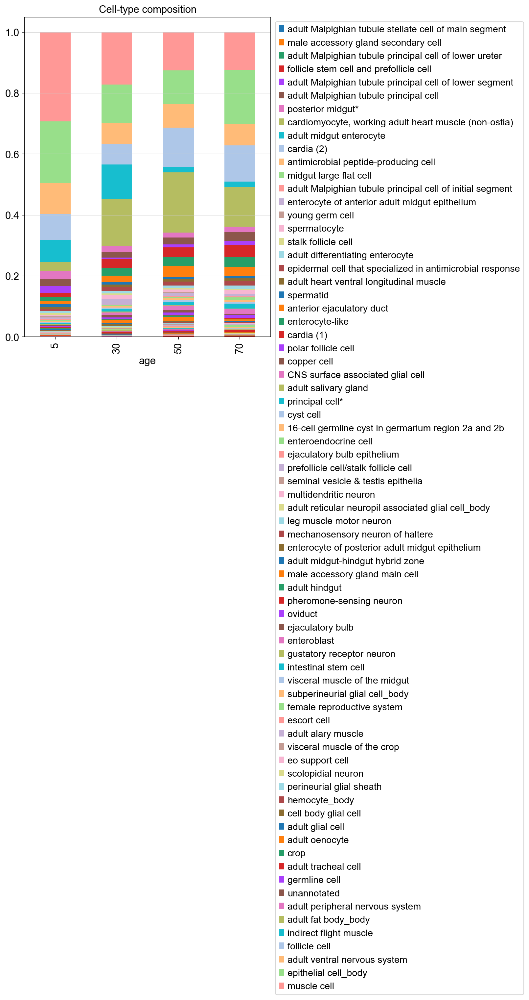

In [39]:
ratioDf=pd.DataFrame(index=annotationDf.index.to_list(), columns=['5d_ratio', '30d_ratio', '50d_ratio', '70d_ratio'])
for age in age_L:
    ratioDf[f'{age}d_ratio'] = ( annotationDf[f'{age}d_cell#']/sum(annotationDf[f'{age}d_cell#']) )
ratioDf = ratioDf.sort_values(by=['5d_ratio'])

ratioT_Df=ratioDf.transpose()
ratioT_Df.insert(0, 'age', age_L)

with rc_context({'figure.figsize': (6, 8)}): 
    ax=ratioT_Df.plot(
        x = 'age',
        kind = 'bar',
        stacked = True,
        title = 'Cell-type composition'
    )
    ax.grid(axis='x',visible=False)
    # plt.legend(loc='lower right')
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.tight_layout()
    plt.savefig(f'{figurePicFolder}/{fcaTissue}_barplot_degRatio_normalizeInterval.pdf')
    plt.show()


### Relative ratio (normalize to previous time point)
Filter cell types with cellN <500

In [40]:
normalRatio_Df=ratioDf[:]
normalRatio_Df=normalRatio_Df.drop(['unannotated'], axis=0)
normalRatio_Df=normalRatio_Df[normalRatio_Df.index.isin(celltypeN500_Df.annotation.to_list())]

In [41]:
for i in range(3):
    age=age_L[i]
    age2=age_L[i+1]
    # print(age)    
    normalRatio_Df[f'{age2}d/{age}d_ratio']=normalRatio_Df[f'{age2}d_ratio']/normalRatio_Df[f'{age}d_ratio']

normalRatio_Df=normalRatio_Df.iloc[:,4:]
normalRatioNoLog2_Df=normalRatio_Df
normalRatio_Df=np.log2(normalRatio_Df)

normalRatioNoLog2_Df=normalRatioNoLog2_Df.sort_values(by='30d/5d_ratio', ascending=False)
normalRatio_Df=normalRatio_Df.sort_values(by='30d/5d_ratio', ascending=False)

In [42]:
normalRatio_Df.insert(0, 'annotation', normalRatio_Df.index.to_list())
normalRatio_longDf=normalRatio_Df.melt(id_vars=['annotation'], var_name='ageCompare', value_name='log2ratio')
normalRatio_longDf

,annotation,ageCompare,log2ratio
0,cardia (1),30d/5d_ratio,3.366614
1,adult fat body_body,30d/5d_ratio,2.441033
2,adult salivary gland,30d/5d_ratio,2.402504
3,male accessory gland main cell,30d/5d_ratio,2.174354
4,adult alary muscle,30d/5d_ratio,2.091784
...,...,...,...
118,epithelial cell_body,70d/50d_ratio,0.683863
119,muscle cell,70d/50d_ratio,-0.028872
120,visceral muscle of the crop,70d/50d_ratio,-0.553543
121,escort cell,70d/50d_ratio,0.702478


In [43]:
dfAll=pd.concat([normalRatio_Df, 
           annotationDf.loc[normalRatio_Df.index.to_list(),:].drop(['TotalCell#', '5d_cell#'], axis=1)], 
          axis=1)
# dfAll

In [44]:
dotplot_Df=dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[1:4]), 
                      var_name='ageCompare', value_name='log2ratio')
# dotplot_Df

dotplot_Df=pd.concat([dotplot_Df, 
           dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[4:]), 
                      var_name='ageCompare', value_name='cellN').iloc[:,2] ], 
          axis=1) # 

In [45]:
normalRatio_Df.drop('annotation', axis=1, inplace=True)

/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_5208/3519999153.py:11: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_5208/3519999153.py:11: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_5208/3519999153.py:13: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.savefig(f'{figurePicFolder}/{fcaTissue}_dotplot_cellRatio_normalizeInterval.pdf')
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T

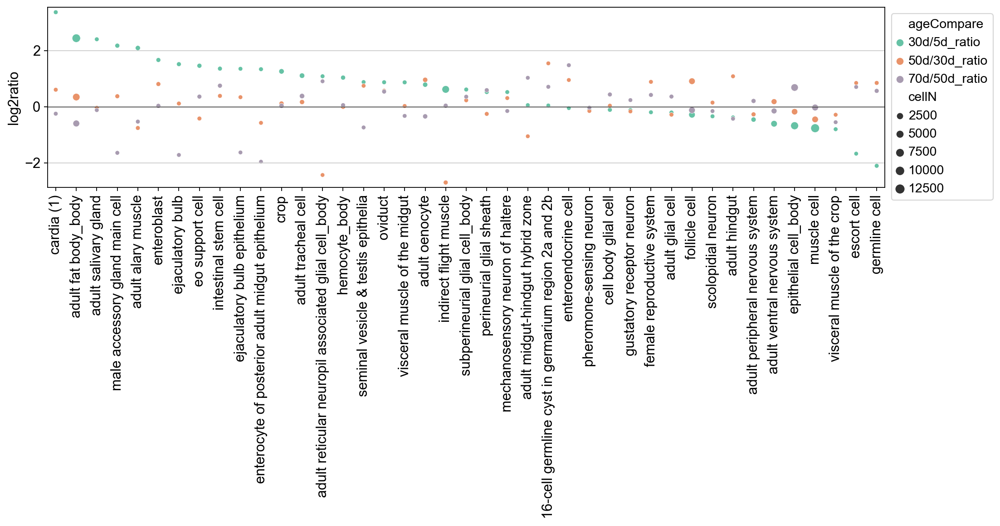

In [52]:
with rc_context({'figure.figsize': (14, 7.5)}):
    ax=sns.scatterplot(data=dotplot_Df, 
                       x="annotation", y="log2ratio", hue="ageCompare", size='cellN', palette=set2Color_L)
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.savefig(f'{figurePicFolder}/{fcaTissue}_dotplot_cellRatio_normalizeInterval.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

In [47]:
annotationDf.to_csv(f'{cellnFolder}/{fcaTissue}_cellN_normalizeInterval.csv')

In [48]:
ratioDf.to_csv(f'{cellnFolder}/{fcaTissue}_ratioDf_normalizeInterval.csv')
dotplot_Df.to_csv(f'{cellnFolder}/{fcaTissue}_ratioDf_dotplot_Df_normalizeInterval.csv')

In [49]:
normalRatio_Df.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatioDf_normalizeInterval.csv')
normalRatioNoLog2_Df.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatioNoLog2_Df_normalizeInterval.csv')
normalRatio_longDf.to_csv(f'{cellnFolder}/{fcaTissue}_normalRatio_longDf_normalizeInterval.csv')

### Combine body and head data: normalize to previous age

In [50]:
ratio_body_Df=pd.read_csv(f'{cellnFolder}/body_normalRatioDf_normalizeInterval.csv')
ratio_head_Df=pd.read_csv(f'{cellnFolder}/head_normalRatioDf_normalizeInterval.csv')

ratio_body_Df['tissue']='body'
ratio_head_Df['tissue']='head'

ratio_all_Df = pd.concat([ratio_body_Df, ratio_head_Df])
ratio_all_Df.columns=['annotation'] + ratio_all_Df.columns[1:].to_list()
ratio_all_Df=ratio_all_Df.reset_index()
ratio_all_Df.index=ratio_all_Df.annotation.to_list()
ratio_all_Df=ratio_all_Df.sort_values(by='30d/5d_ratio', ascending=False)

ratio_all_Df

,index,annotation,30d/5d_ratio,50d/30d_ratio,70d/50d_ratio,tissue
cardia (1),0,cardia (1),3.366614,0.604317,-0.250471,body
pericerebral adult fat mass,0,pericerebral adult fat mass,3.084385,-1.129970,1.102887,head
adult brain cell body glial cell,1,adult brain cell body glial cell,2.750703,-0.862194,0.519624,head
adult fat body_body,1,adult fat body_body,2.441033,0.343037,-0.598453,body
adult salivary gland,2,adult salivary gland,2.402504,-0.038071,-0.122683,body
...,...,...,...,...,...,...
T neuron T4/T5a-b,87,T neuron T4/T5a-b,-1.058361,0.469333,-0.226803,head
medullary intrinsic neuron Mi9,88,medullary intrinsic neuron Mi9,-1.086373,0.391546,-0.869175,head
neuron 7,89,neuron 7,-1.124171,0.593123,-0.678309,head
escort cell,39,escort cell,-1.675038,0.844778,0.702478,body


In [53]:
ratio_all_mtx=ratio_all_Df.drop(['index', 'annotation'], axis=1)
ratio_all_mtx.to_csv(f'{cellnFolder}/headBody_cellN_log2Ratio_normalizeInterval.csv')
ratio_all_mtx=ratio_all_Df.drop(['index', 'annotation', 'tissue'], axis=1)

ratio_all_mtx

,30d/5d_ratio,50d/30d_ratio,70d/50d_ratio
cardia (1),3.366614,0.604317,-0.250471
pericerebral adult fat mass,3.084385,-1.129970,1.102887
adult brain cell body glial cell,2.750703,-0.862194,0.519624
adult fat body_body,2.441033,0.343037,-0.598453
adult salivary gland,2.402504,-0.038071,-0.122683
...,...,...,...
T neuron T4/T5a-b,-1.058361,0.469333,-0.226803
medullary intrinsic neuron Mi9,-1.086373,0.391546,-0.869175
neuron 7,-1.124171,0.593123,-0.678309
escort cell,-1.675038,0.844778,0.702478


In [54]:
dotplot_body_Df=pd.read_csv(f'{cellnFolder}/body_ratioDf_dotplot_Df_normalizeInterval.csv')
dotplot_head_Df=pd.read_csv(f'{cellnFolder}/head_ratioDf_dotplot_Df_normalizeInterval.csv')

dotplot_body_Df['tissue']='body'
dotplot_head_Df['tissue']='head'

In [55]:
dotplot_all_Df=pd.concat([dotplot_body_Df, dotplot_head_Df])
dotplot_all_Df=dotplot_all_Df.sort_values(by='log2ratio', ascending=False)
dotplot_all_Df.reset_index(inplace=True)
dotplot_all_Df

,index,Unnamed: 0,annotation,ageCompare,log2ratio,cellN,tissue
0,0,0,cardia (1),30d/5d_ratio,3.366614,397.0,body
1,0,0,pericerebral adult fat mass,30d/5d_ratio,3.084385,1594.0,head
2,1,1,adult brain cell body glial cell,30d/5d_ratio,2.750703,423.0,head
3,1,1,adult fat body_body,30d/5d_ratio,2.441033,13158.0,body
4,2,2,adult salivary gland,30d/5d_ratio,2.402504,259.0,body
...,...,...,...,...,...,...,...
388,88,88,ejaculatory bulb,70d/50d_ratio,-1.721147,125.0,body
389,92,92,enterocyte of posterior adult midgut epithelium,70d/50d_ratio,-1.961522,40.0,body
390,40,40,germline cell,30d/5d_ratio,-2.107656,452.0,body
391,54,54,adult reticular neuropil associated glial cell...,50d/30d_ratio,-2.434854,29.0,body


In [56]:
dotplot_Order=dotplot_all_Df[
    dotplot_all_Df.ageCompare == '30d/5d_ratio'].sort_values(by='log2ratio', ascending=False).annotation.to_list()
# dotplot_Order

In [57]:
dotplot_TissueOrder_Df=pd.DataFrame(dotplot_all_Df[
    dotplot_all_Df.ageCompare == '30d/5d_ratio'].sort_values(by='log2ratio', ascending=False).tissue.to_list(),
                                   index=dotplot_Order, columns=['tissue'])

In [58]:
dotplot_allNew_Df=pd.DataFrame(columns=dotplot_all_Df.columns.to_list())
for annotOrder in dotplot_Order:
    dotplot_allNew_Df=pd.concat([dotplot_allNew_Df, 
                                 dotplot_all_Df[dotplot_all_Df.annotation == annotOrder]])
dotplot_allNew_Df.reset_index(inplace=True)
dotplot_allNew_Df=dotplot_allNew_Df.iloc[:, 3:]
dotplot_allNew_Df['annotation']=pd.Categorical(dotplot_allNew_Df['annotation'], ordered=True, 
                                               categories=dotplot_Order)
dotplot_allNew_Df['ageCompare']=pd.Categorical(dotplot_allNew_Df['ageCompare'], ordered=True, 
                                               categories=['30d/5d_ratio', '50d/30d_ratio', '70d/50d_ratio'])

dotplot_allNew_Df

,annotation,ageCompare,log2ratio,cellN,tissue
0,cardia (1),30d/5d_ratio,3.366614,397.0,body
1,cardia (1),50d/30d_ratio,0.604317,323.0,body
2,cardia (1),70d/50d_ratio,-0.250471,300.0,body
3,pericerebral adult fat mass,30d/5d_ratio,3.084385,1594.0,head
4,pericerebral adult fat mass,70d/50d_ratio,1.102887,1374.0,head
...,...,...,...,...,...
388,escort cell,70d/50d_ratio,0.702478,178.0,body
389,escort cell,30d/5d_ratio,-1.675038,103.0,body
390,germline cell,50d/30d_ratio,0.846615,435.0,body
391,germline cell,70d/50d_ratio,0.562905,710.0,body


/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_5208/3396514385.py:13: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_5208/3396514385.py:13: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.tight_layout()
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ipykernel_5208/3396514385.py:14: MatplotlibDeprecationWarning: Support for passing numbers through unit converters is deprecated since 3.5 and support will be removed two minor releases later; use Axis.convert_units instead.
  plt.savefig(f'{figurePicFolder}/headBody_dotplot_cellRatio_normalizeAdjacent.pdf')
/var/folders/jj/t95qp6v1343877pd7n071t200000gp/T/ip

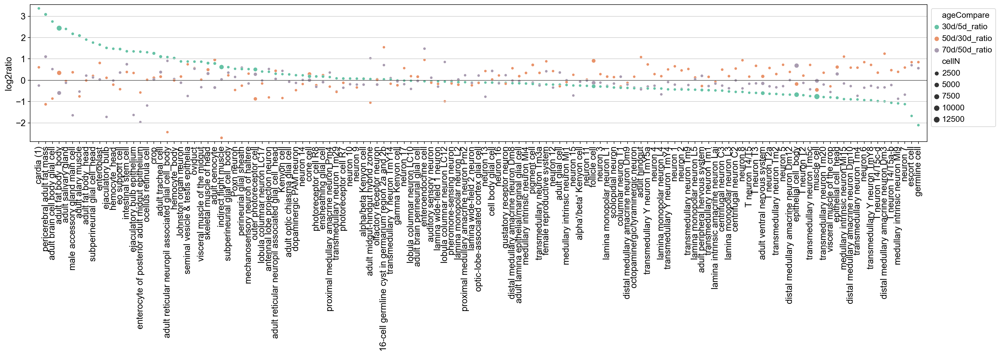

In [61]:
with rc_context({'figure.figsize': (22, 8)}):
    ax=sns.scatterplot(data=dotplot_allNew_Df, 
                       x="annotation", y="log2ratio", hue="ageCompare", size='cellN', palette=set2Color_L) # "#F1BB7B", "#FD6467", "#5B1A18"
    ax.margins(0.01, 0.03)
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    # plt.legend(['30d/5d_ratio', '50d/5d_ratio', '70d/5d_ratio'])
    plt.tight_layout()
    plt.savefig(f'{figurePicFolder}/headBody_dotplot_cellRatio_normalizeAdjacent.pdf')
    plt.show()

In [62]:
df=pd.DataFrame(ratio_all_Df.tissue).T

In [63]:
value_to_int={'body':0, 'head': 1}
# value_to_int
n = len(value_to_int)    
cmap=sns.color_palette("Set3", 8) # Pastel2
cmap

[(0.5529411764705883, 0.8274509803921568, 0.7803921568627451),
 (1.0, 1.0, 0.7019607843137254),
 (0.7450980392156863, 0.7294117647058823, 0.8549019607843137),
 (0.984313725490196, 0.5019607843137255, 0.4470588235294118),
 (0.5019607843137255, 0.6941176470588235, 0.8274509803921568),
 (0.9921568627450981, 0.7058823529411765, 0.3843137254901961),
 (0.7019607843137254, 0.8705882352941177, 0.4117647058823529),
 (0.9882352941176471, 0.803921568627451, 0.8980392156862745)]

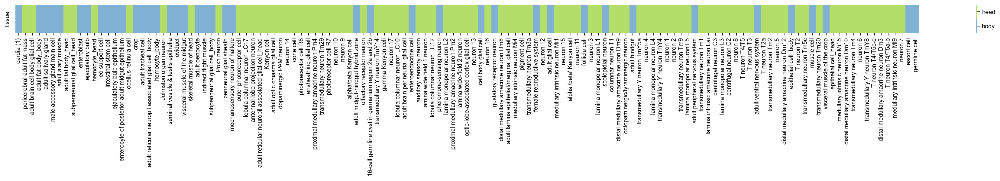

In [64]:
# with rc_context({'figure.figsize': (40, 7)}):
plt.figure(figsize=(24, 4))
parameters = {'xtick.labelsize': 9,'ytick.labelsize': 9, 'legend.fontsize':9}
plt.rcParams.update(parameters)

ax = sns.heatmap(df.replace(value_to_int), cmap=[cmap[4], cmap[6]], xticklabels=True )
colorbar=ax.collections[0].colorbar
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n * (0.5 + i) for i in range(n)])
colorbar.set_ticklabels(value_to_int.keys()) #not in the right order
# colorbar.set_ticklabels(['head', 'body'])
# plt.xlabel('', fontsize=20)
# ax.xaxis.label.set_size(50)
plt.tight_layout()
plt.savefig(f'{figurePicFolder}/headBody_barplot_cellRatio_tissue_normalizeAdjacent.pdf')

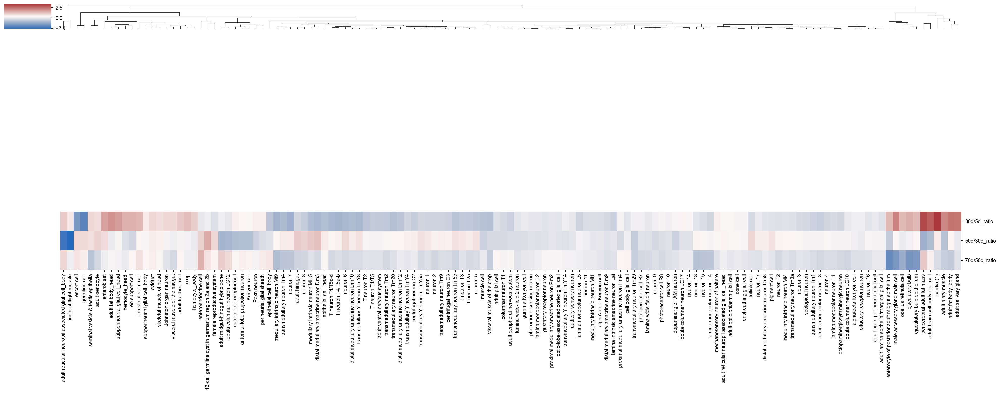

In [65]:
with rc_context({'figure.figsize': (10, 5)}): 
    # fig, axs = plt.subplots()
    ax=sns.clustermap(ratio_all_mtx.transpose(), xticklabels=True,  dendrogram_ratio=(0.05, 0.3), figsize=(25, 10), row_cluster=False, cmap="vlag", cbar_pos=(.01, .35, .01, 0.3)) # standard_scale=0,  
    plt.setp(ax.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
    # ax.ax.margins(0.01, 0.03)
    plt.tight_layout()
    plt.savefig(f'{figurePicFolder}/headBody_heatmap_cellRatio_normalizeAdjacent.pdf')

In [66]:
ratio_all_mtx_select=\
    ratio_all_mtx[(abs(ratio_all_mtx['30d/5d_ratio']) >= 1) | 
              (abs(ratio_all_mtx['50d/30d_ratio']) >= 1)| 
              (abs(ratio_all_mtx['70d/50d_ratio']) >= 1) ]

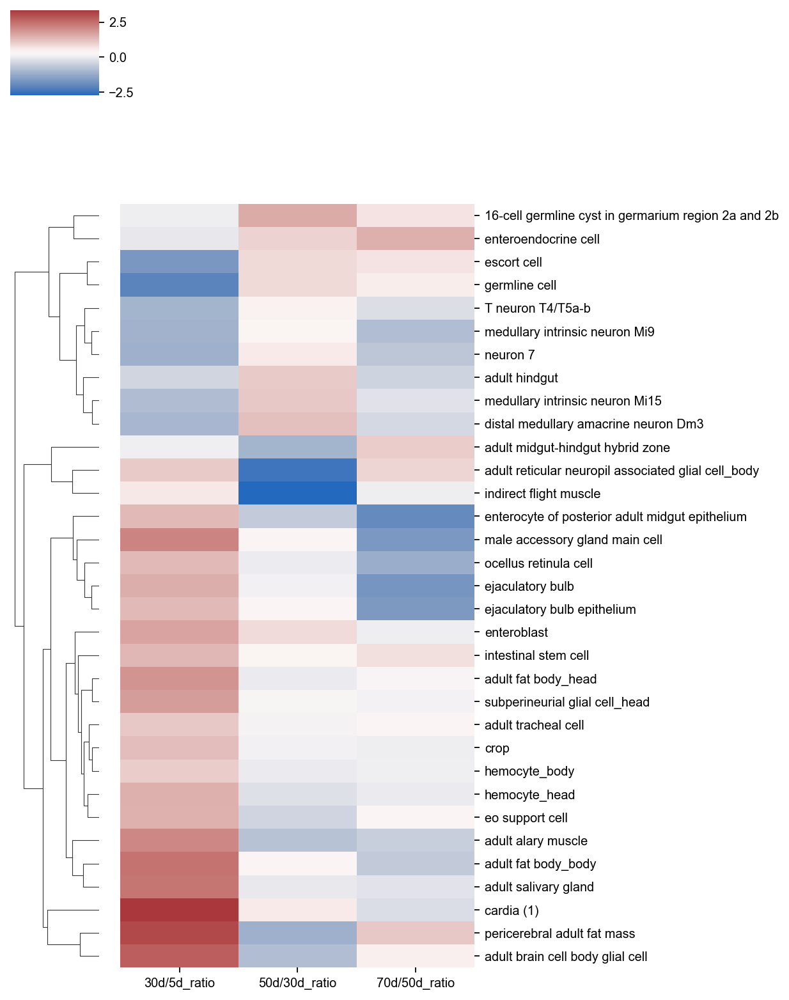

In [67]:
with rc_context({'figure.figsize': (10, 5)}): 
    sns.clustermap(ratio_all_mtx_select, figsize=(8, 10), yticklabels=True, dendrogram_ratio=(0.2, 0.1), col_cluster=False, cmap="vlag") # standard_scale=1, 
    plt.tight_layout()
    plt.savefig(f'{figureFolder}/headBody_heatmap_cellRatio_normalizeAdjacent_fc1.pdf')

In [68]:
ratio_all_mtx_select=\
    ratio_all_mtx[(abs(ratio_all_mtx['30d/5d_ratio']) >= 1.5) | 
              (abs(ratio_all_mtx['50d/30d_ratio']) >= 1.5)| 
              (abs(ratio_all_mtx['70d/50d_ratio']) >= 1.5) ]

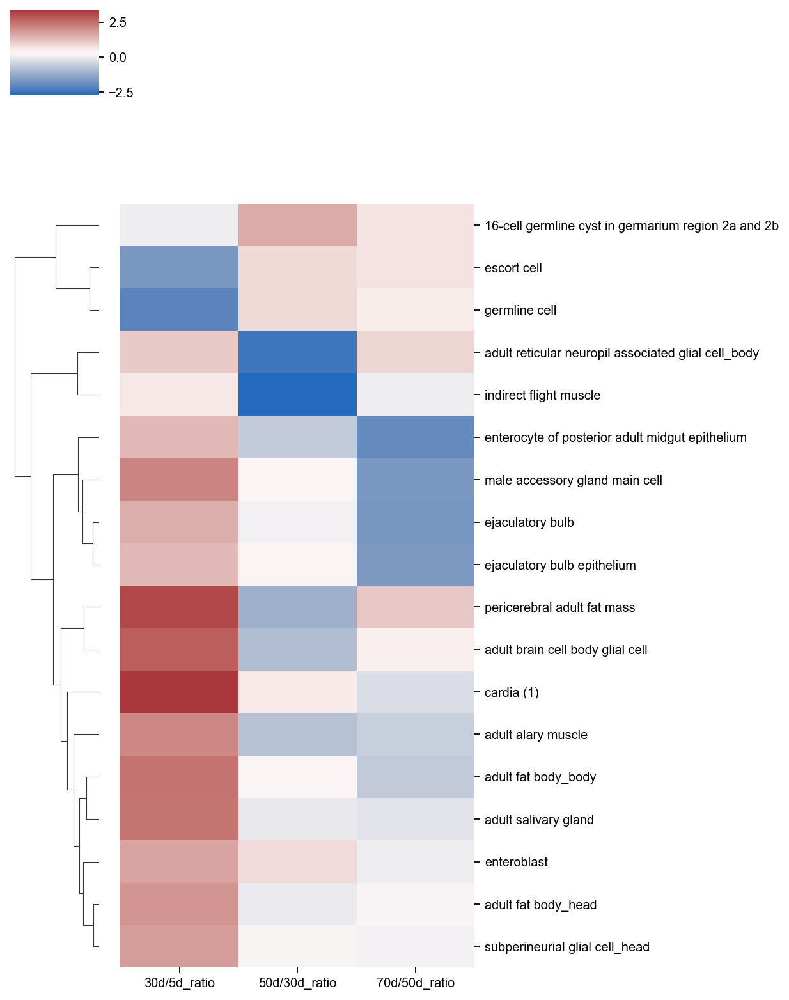

In [69]:
with rc_context({'figure.figsize': (10, 5)}): 
    sns.clustermap(ratio_all_mtx_select, figsize=(8, 10), yticklabels=True, dendrogram_ratio=(0.2, 0.1), col_cluster=False, cmap="vlag") # standard_scale=1, 
    plt.tight_layout()
    plt.savefig(f'{figureFolder}/headBody_heatmap_cellRatio_normalizeAdjacent_fc1.5.pdf')

In [70]:
dotplot_allNew_Df.to_csv(f'{compositionFolder}/dotplot_all_Df_normalizeAdjacent.csv', index=False)

# Sup: loss of muscle markers

In [41]:
adata_body=sc.read(f'{allHeadBodyDataFolder}/adata_body_R_v1.0.h5ad')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:55)


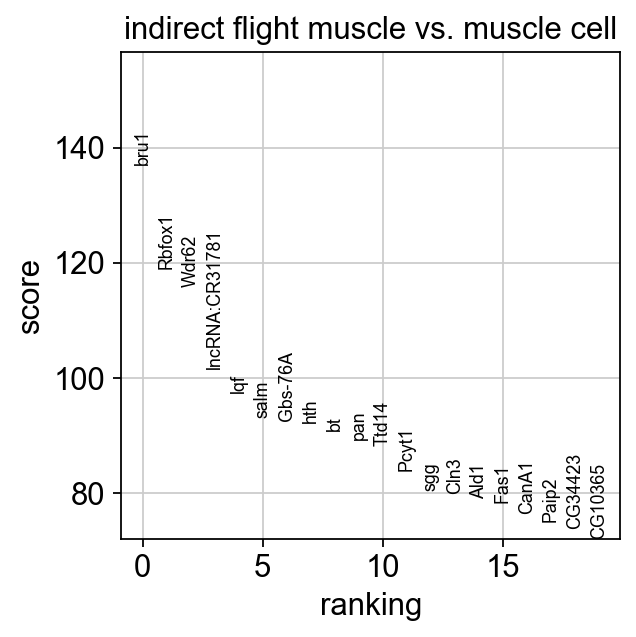

In [45]:
sc.tl.rank_genes_groups(adata_body, 'afca_annotation', groups=['indirect flight muscle'], reference='muscle cell', method='wilcoxon')
sc.pl.rank_genes_groups(adata_body, groups=['indirect flight muscle'], n_genes=20)

In [46]:
adata_body

AnnData object with n_obs × n_vars = 276273 × 2588
    obs: 'cellBC', 'sampleGroup', 'sex', 'tissue', 'age', 'sampleN', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rRNA', 'pct_counts_rRNA', 'batch', 'dataset', 'fca_id', 'R_annotation', 'R_annotation__ontology_id', 'R_annotation_broad', 'R_annotation_broad__ontology_id', 'annotation', 'annotation__ontology_id', 'annotation_broad', 'annotation_broad__ontology_id', 'annotation_broad_extrapolated', 'annotation_broad_extrapolated__ontology_id', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_rRNA', 'leiden', 'leiden_1.0', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'leiden_20.0', 'leiden_30.0', 'leiden_40.0', 'leiden_50.0', 'sex_age', 'true', 'linearR_annotation', 'afca_annotation', 'afca_annotation_broad'
    var: 'gene_ids-0-0', 'geneName-0-0', 'gene_ids-1-0'

In [56]:
adata_body.uns['rank_genes_groups']['names'].tolist()[:30]

[('bru1',),
 ('Rbfox1',),
 ('Wdr62',),
 ('lncRNA:CR31781',),
 ('lqf',),
 ('salm',),
 ('Gbs-76A',),
 ('hth',),
 ('bt',),
 ('pan',),
 ('Ttd14',),
 ('Pcyt1',),
 ('sgg',),
 ('Cln3',),
 ('Ald1',),
 ('Fas1',),
 ('CanA1',),
 ('Paip2',),
 ('CG34423',),
 ('CG10365',),
 ('Ehbp1',),
 ('gce',),
 ('pHCl-1',),
 ('cdi',),
 ('CG3198',),
 ('Nc73EF',),
 ('plh',),
 ('gw',),
 ('CG1674',),
 ('sm',)]

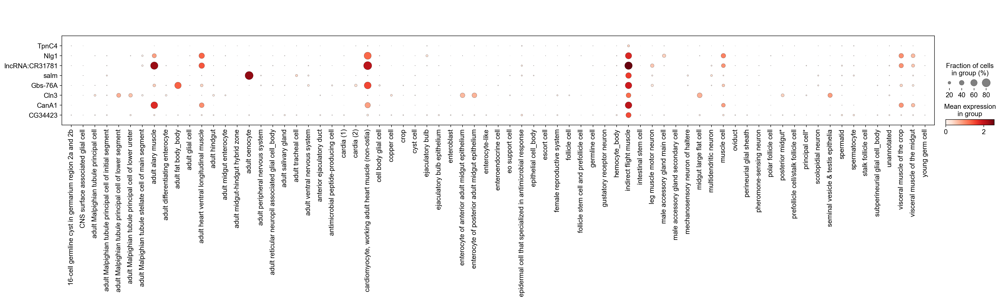

In [83]:
sc.pl.dotplot(adata_body, var_names=['TpnC4', 'Nlg1', 'lncRNA:CR31781','salm', 'Gbs-76A', 'Cln3', 'CanA1', 'CG34423'], groupby='afca_annotation', swap_axes=True,
              save='_IFM_markers')
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


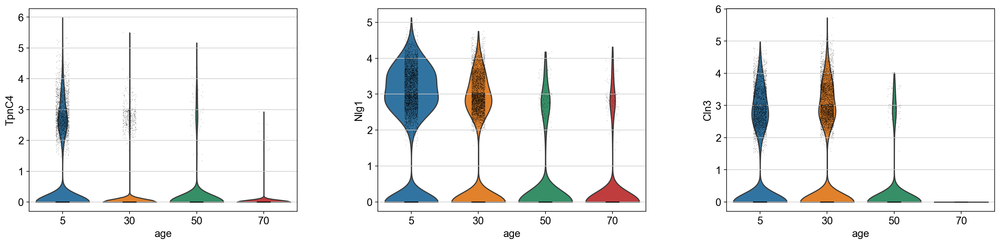

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


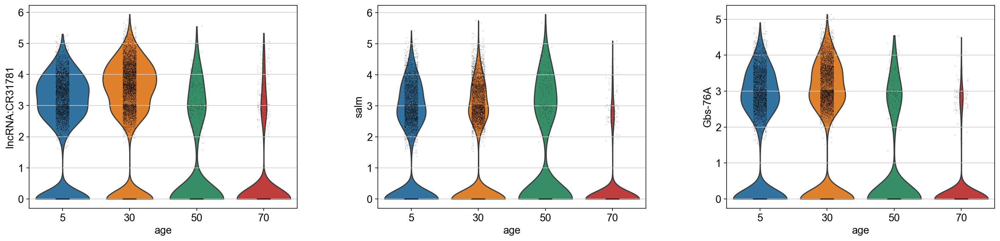

In [80]:
cellType='indirect flight muscle'
with rc_context({'figure.figsize': (6, 5)}): 
    sc.pl.violin(adata_body[adata_body.obs.afca_annotation == cellType], keys=['TpnC4', 'Nlg1', 'Cln3'], groupby='age', save=f'_IFM_TpnC4_Nlg1_Cln3.pdf', size=0.5, ncol=3)
    sc.pl.violin(adata_body[adata_body.obs.afca_annotation == cellType], keys=['lncRNA:CR31781','salm', 'Gbs-76A',], groupby='age', save=f'_IFM_lncRNA-CR31781_salm_Gbs-76A.pdf', size=0.5, ncol=3)
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


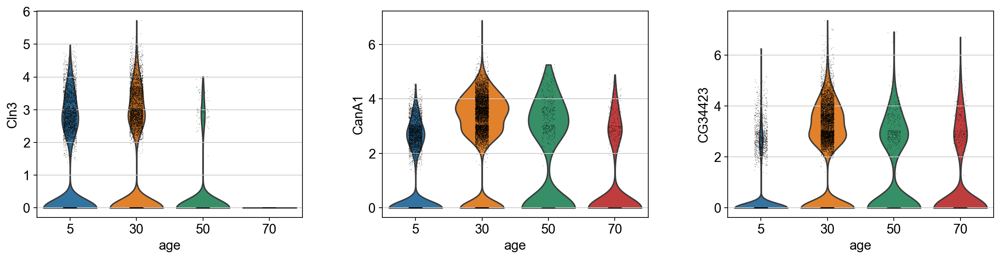

In [82]:
with rc_context({'figure.figsize': (5, 4)}):
    sc.pl.violin(adata_body[adata_body.obs.afca_annotation.isin(['indirect flight muscle'])], keys=['Cln3', 'CanA1', 'CG34423'], groupby='age', size=0.5)

# Sup: markers of renal stem cells and intestinal stem cells

In [17]:
adata_gut=sc.read(f'{harmonyAnalysisFolder}/withFCA_body_v0.5/gut/adata_tissue_7.afca_annotation_stringent.h5ad')

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


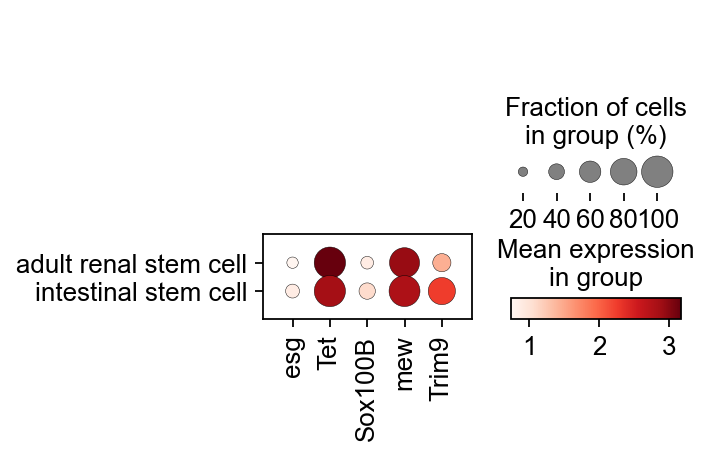

In [39]:
# marker genes similiarlly expressed between ISC & RSC
with rc_context({'figure.figsize': (3, 3)}): 
    sc.pl.dotplot(adata_gut[adata_gut.obs.afca_annotation.isin(['adult renal stem cell', 'intestinal stem cell'])], 
                  var_names=['esg', 'Tet', 'Sox100B', 'mew', 'Trim9'], groupby='afca_annotation',
                  save=f'_isc_rsc_sharedMarkers.pdf')
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

# Sup: transfer consistency

In [17]:
annotTransfer_Df=pd.read_csv(f'{figureFolder}/summary_annotationTransfer.csv')
annotTransfer_Df.tissue = [' '.join(x.split('_')) for x in annotTransfer_Df.tissue.to_list()]
annotTransfer_Df.iloc[9, 0]='gut & malpighian tubule'
annotTransfer_Df.index = annotTransfer_Df.tissue.to_list()
annotTransfer_Df

,tissue,coClusterAnnotation,wManual_annotation
head,head,82.26,79.81
body,body,79.88,91.31
adult fat body,adult fat body,59.45,87.75
adult neuron,adult neuron,73.03,73.04
adult oenocyte,adult oenocyte,69.50,80.39
adult salivary gland,adult salivary gland,88.64,94.12
adult tracheal cell,adult tracheal cell,84.13,79.64
body wall,body wall,72.01,74.56
epithelial cell,epithelial cell,85.50,72.69
gut & malpighian tubule,gut & malpighian tubule,68.56,67.85


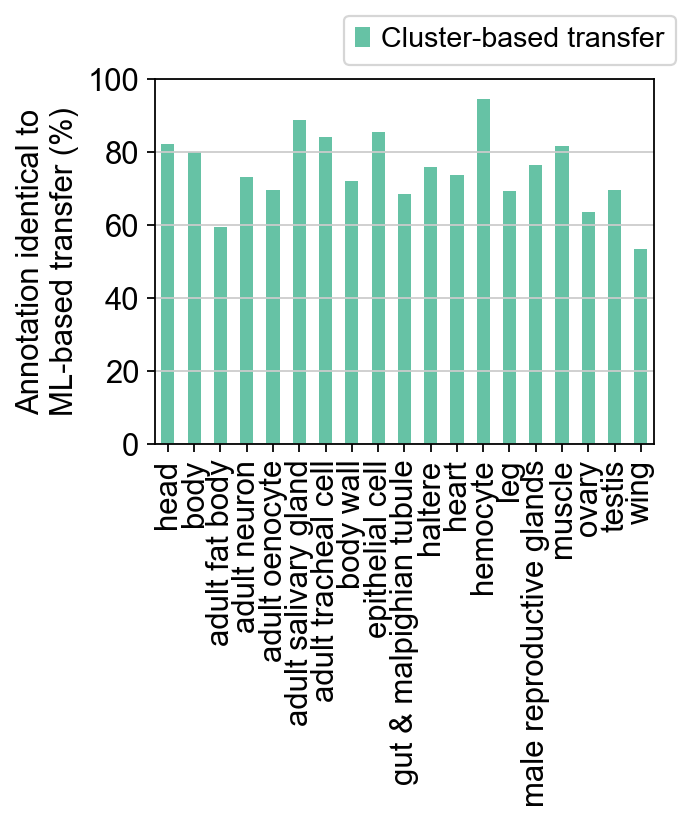

In [24]:
with rc_context({'figure.figsize': (4, 3)}):
    ax = annotTransfer_Df.loc[:,['tissue', 'coClusterAnnotation']].plot.bar(rot=90, color=set2Color_L[:2])
    # ax=sns.barplot(data=annotTransfer_Df, x='tissue', y='coClusterAnnotation', color='steelblue')
    # plt.title('Annotations identical to logistic regression')
    plt.ylim(0, 100)
    ax.grid(axis='x',visible=False)
    
    # ax.legend(han)
    plt.legend(['Cluster-based transfer', ],bbox_to_anchor=(0.35, 1.0)) # ['co-clustering', ]
    plt.xlabel('')
    plt.ylabel('Annotation identical to\nML-based transfer (%)')
    plt.xticks(rotation=90)
    
    plt.savefig(f'{figurePicFolder}/annotationConsistency_clusterTransfer.pdf', bbox_inches='tight')

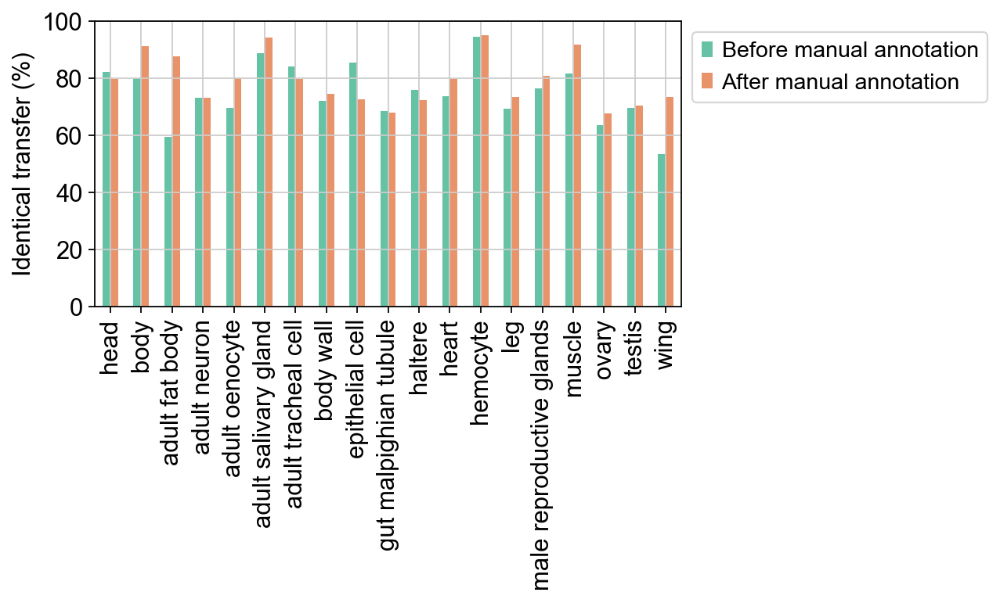

In [61]:
with rc_context({'figure.figsize': (6, 3)}):
    ax = annotTransfer_Df.plot.bar(rot=90, color=set2Color_L[:2])
    # ax=sns.barplot(data=annotTransfer_Df, x='tissue', y='coClusterAnnotation', color='steelblue')
    # plt.title('Annotations identical to logistic regression')
    plt.ylim(0, 100)
    
    # ax.legend(han)
    plt.legend(['Before manual annotation', 'After manual annotation'],bbox_to_anchor=(1.0, 1.0)) # ['co-clustering', ]
    plt.xlabel('')
    plt.ylabel('Identical transfer (%)')
    plt.xticks(rotation=90)
    
    plt.savefig(f'{figurePicFolder}/annotationConsistency.pdf', bbox_inches='tight')

# Sup: Highlight some gut cell types

## Combine gut dataset

In [15]:
adata_body=sc.read(f'{allHeadBodyDataFolder}/adata_body_R_v1.0.h5ad')

In [16]:
gut_L = ['intestinal stem cell', 'enteroblast', 'adult differentiating enterocyte', 'enterocyte of anterior adult midgut epithelium', 'enterocyte of posterior adult midgut epithelium', 'enteroendocrine cell']

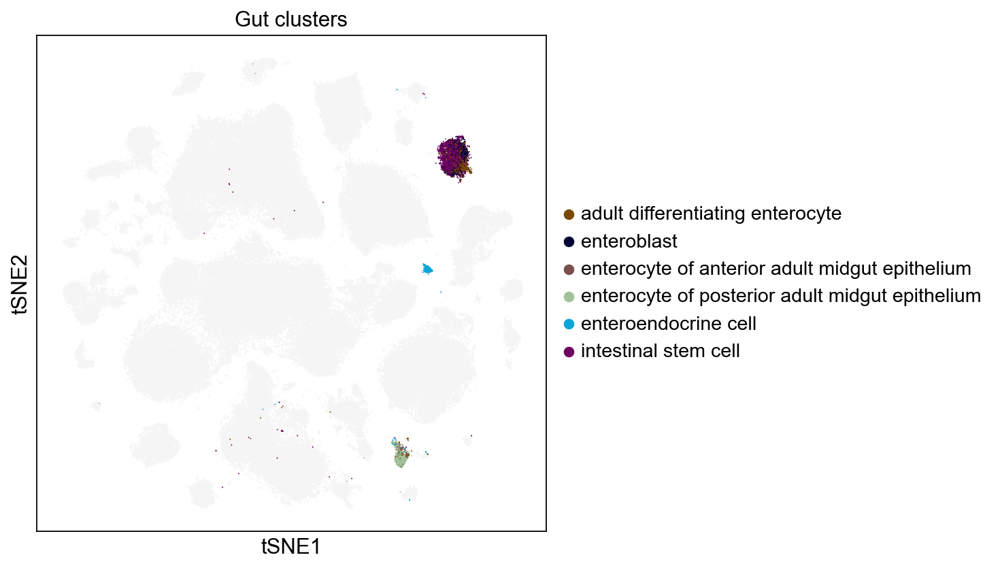

In [17]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_body, color='afca_annotation', groups=gut_L, na_in_legend=False, size=3, title='Gut clusters', na_color='whitesmoke',
               save=f'_gutClusters.pdf') # show=False, 
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

In [18]:
gutGroup_L=[]
for i, annot in enumerate(adata_body.obs.afca_annotation):
    if annot in gut_L: gutGroup_L.append('Gut')
    else: gutGroup_L.append(np.nan)
    
adata_body.obs['gutGroup'] = pd.Categorical(gutGroup_L)

In [19]:
adata_body.obs['gutGroup'].value_counts()

Gut    6138
Name: gutGroup, dtype: int64

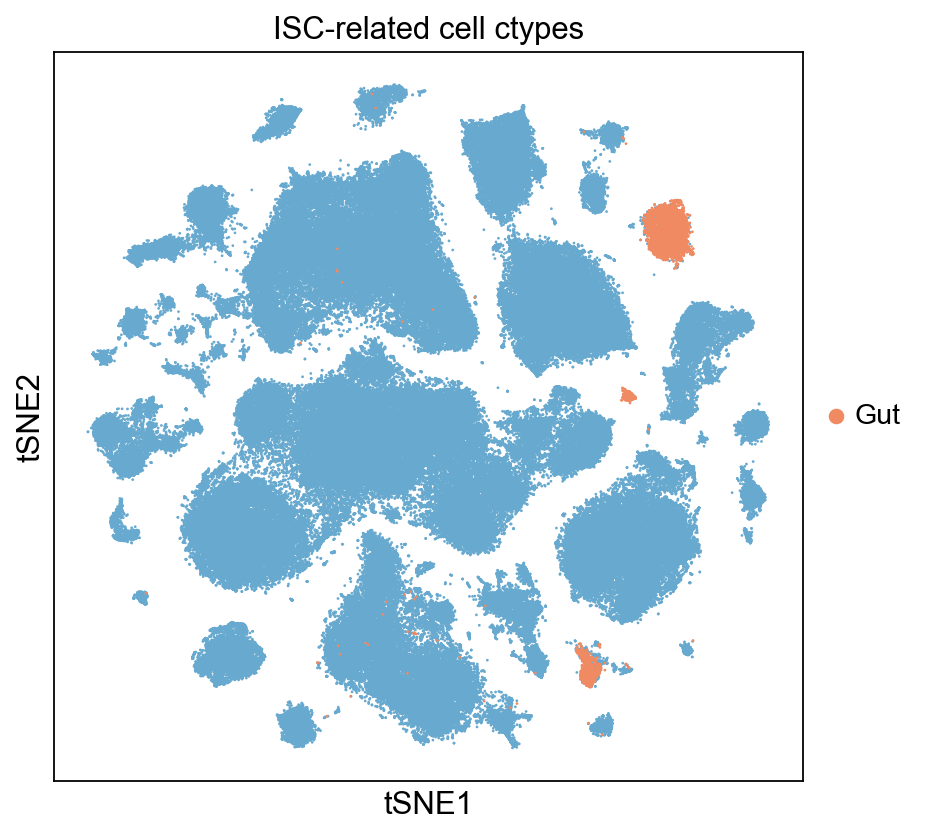

In [34]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_body, color='gutGroup', na_in_legend=False, size=6, title='ISC-related cell ctypes', na_color='#67a9cf', palette=['#ef8a62'], # na_color='whitesmoke', ['#ef8a62','#f7f7f7','#67a9cf']
               save=f'_gutClusters_oneColor.pdf') # show=False,  # palette=['#e41a1c'],
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

# Sup: Highlight ISC

In [84]:
adata_gut=sc.read(f'{harmonyAnalysisFolder}/withFCA_body_v0.5/gut/adata_tissue_8.afca_annotation_stringent_indexModified_isc_11052022.h5ad')

In [17]:
adata_ISC_harmonyAgeSex=sc.read(f'{harmonyAnalysisFolder}/withFCA_body_v0.5/gut/adata_ISC_harmonyAgeSex_modifyAnnotation_11052022.h5ad')
adata_ISC_harmonyAgeSex

AnnData object with n_obs × n_vars = 8016 × 2663
    obs: 'cellBC', 'sampleGroup', 'sex', 'tissue', 'age', 'sampleN', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rRNA', 'pct_counts_rRNA', 'batch', 'dataset', 'fca_id', 'S_annotation', 'S_annotation__ontology_id', 'S_annotation_broad', 'S_annotation_broad__ontology_id', 'S_annotation_broad_extrapolated', 'S_annotation_broad_extrapolated__ontology_id', 'annotation', 'annotation__ontology_id', 'annotation_broad', 'annotation_broad__ontology_id', 'R_annotation', 'R_annotation__ontology_id', 'R_annotation_broad', 'R_annotation_broad__ontology_id', 'annotation_broad_extrapolated', 'annotation_broad_extrapolated__ontology_id', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_rRNA', 'leiden', 'leiden_1.0', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'leiden_20.0', '

In [86]:
gut_L = ['intestinal stem cell', 'enteroblast', 'adult differentiating enterocyte', 'adult renal stem cell']

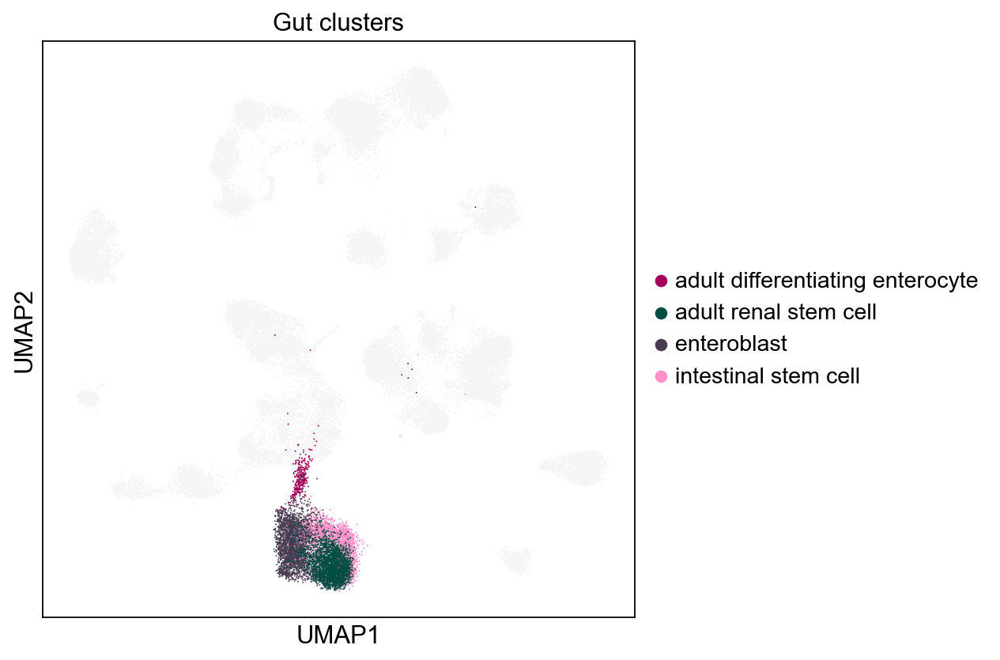

In [87]:
with rc_context({'figure.figsize': (6, 6)}):
    # sc.pl.tsne(adata_gut, color='afca_annotation', groups=gut_L, na_in_legend=False, size=3, title='Gut clusters', na_color='whitesmoke') # show=False, 
    sc.pl.umap(adata_gut, color='afca_annotation', groups=gut_L, na_in_legend=False, size=3, title='Gut clusters', na_color='whitesmoke') 

In [18]:
gutGroup_L=[]
for i, annot in enumerate(adata_gut.obs.afca_annotation):
    if annot in gut_L: gutGroup_L.append('ISC-related cell')
    else: gutGroup_L.append(np.nan)
    
adata_gut.obs['ISC_group'] = pd.Categorical(gutGroup_L)

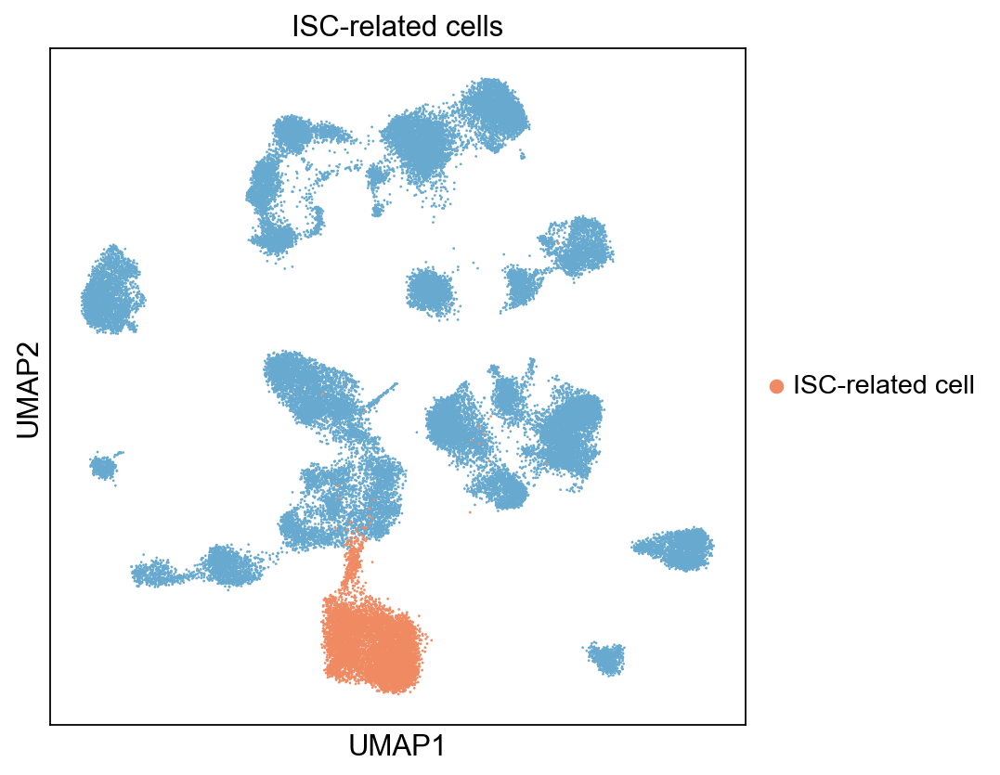

In [19]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata_gut, color='ISC_group', na_in_legend=False, size=6, title='ISC-related cells', na_color='#67a9cf', palette=['#ef8a62'], # na_color='whitesmoke', ['#ef8a62','#f7f7f7','#67a9cf']
               save=f'_iscCells_oneColor.pdf') #  # show=False,  # palette=['#e41a1c'],
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


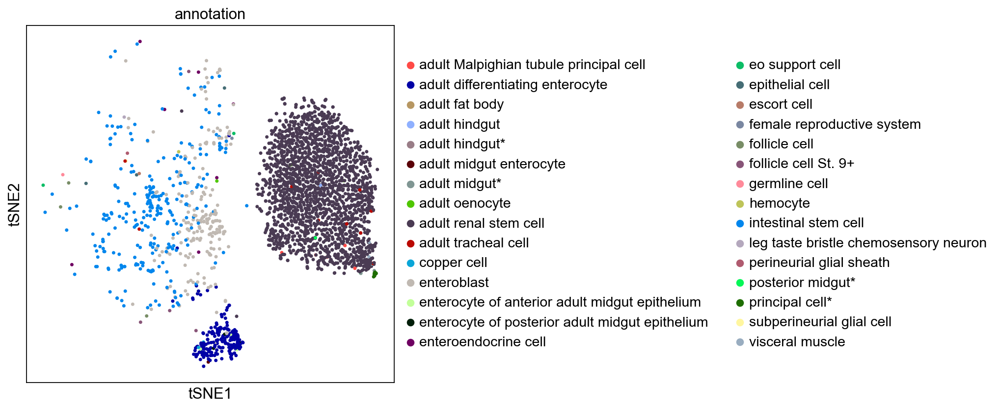

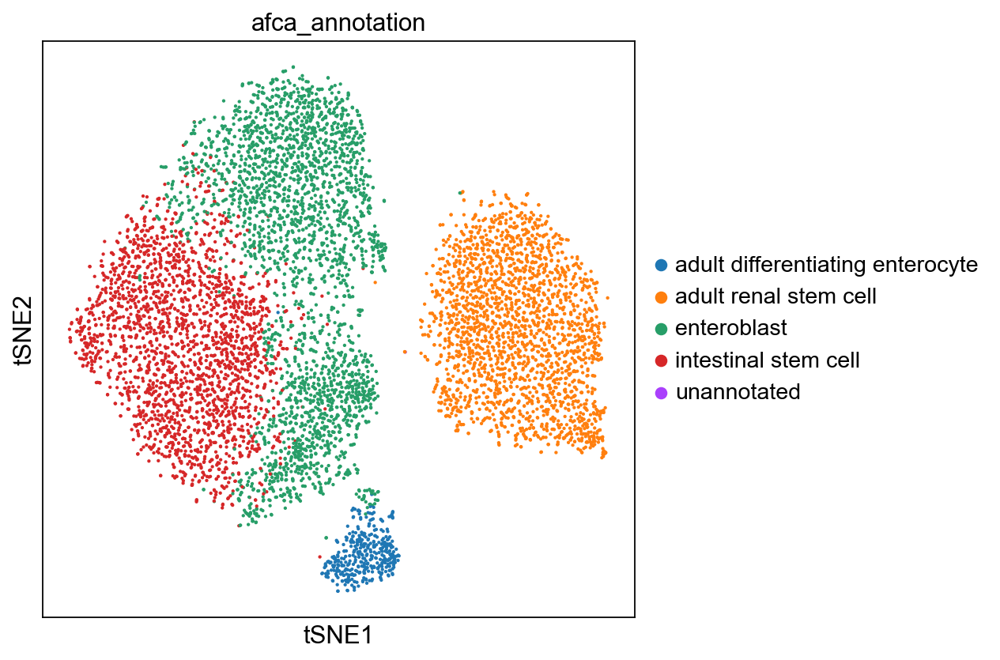

In [33]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_ISC_harmonyAgeSex[(~adata_ISC_harmonyAgeSex.obs.age.isin(age_L[1:])) & (adata_ISC_harmonyAgeSex.obs.annotation != 'unannotated')], color='annotation',
              save=f'_ISC_annotation.pdf')
    sc.pl.tsne(adata_ISC_harmonyAgeSex, color='afca_annotation', save=f'_ISC_afca_annotation.pdf')
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

In [39]:
sc.tl.leiden(adata_ISC_harmonyAgeSex, resolution=0.5)

running Leiden clustering
    finished: found 6 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


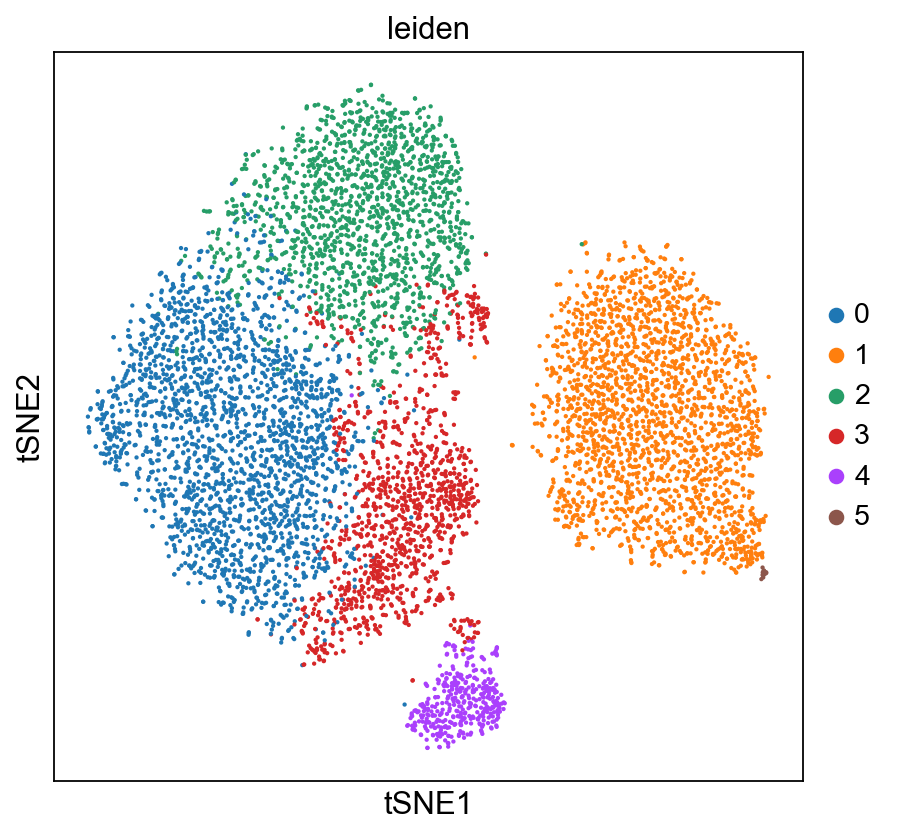

In [42]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_ISC_harmonyAgeSex, color='leiden', save=f'_ISC_leiden.pdf') #
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')

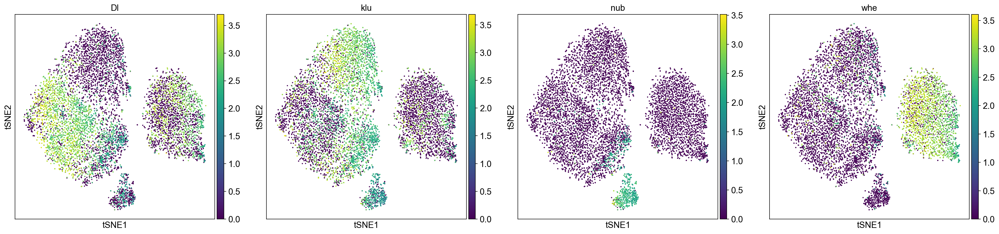

In [43]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_ISC_harmonyAgeSex, color=['Dl', 'klu', 'nub', 'whe'], 
               save=f'_ISC_markers.pdf', ncols=5) # 'MESR3',
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figurePicFolder}/{x}')
    


## ISC-differentiated cell types

In [23]:
adata_body=sc.read(f'{allHeadBodyDataFolder}/adata_body_R_v1.0.h5ad')

In [16]:
adata_gut=sc.read(f'{harmonyAnalysisFolder}/withFCA_body_v0.5/gut/adata_tissue_8.afca_annotation_stringent_indexModified_isc_11052022.h5ad')

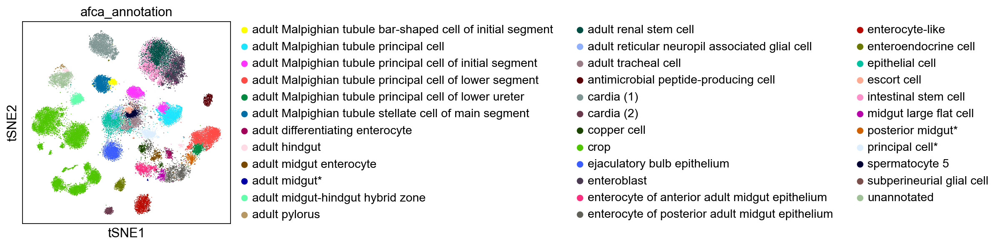

In [17]:
sc.pl.tsne(adata_gut, color='afca_annotation') #11052022

In [18]:
iscDiff_L = ['intestinal stem cell', 'enteroblast', 'adult differentiating enterocyte', 'enterocyte of posterior adult midgut epithelium', 
             'enterocyte of anterior adult midgut epithelium', 'enteroendocrine cell']

In [19]:
adata_iscDiff = adata_gut[adata_gut.obs.afca_annotation.isin(iscDiff_L)]

/Users/tzuchiao/opt/anaconda3/envs/scanpy/lib/python3.9/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [20]:
adata_iscDiff.obs.afca_annotation.value_counts()

enteroblast                                        2770
intestinal stem cell                               2329
enterocyte of posterior adult midgut epithelium    1342
enterocyte of anterior adult midgut epithelium      923
enteroendocrine cell                                592
adult differentiating enterocyte                    299
Name: afca_annotation, dtype: int64

In [21]:
adata_iscDiff[adata_iscDiff.obs.tissue == 'body'].obs.afca_annotation.value_counts()

enteroblast                                        2417
intestinal stem cell                               2158
enterocyte of posterior adult midgut epithelium     752
enteroendocrine cell                                510
enterocyte of anterior adult midgut epithelium      182
adult differentiating enterocyte                     72
Name: afca_annotation, dtype: int64

In [24]:
adata_iscDiff_body = adata_body[adata_body.obs.afca_annotation.isin(iscDiff_L)]
adata_iscDiff_body.obs.afca_annotation.value_counts()

enteroblast                                        2417
intestinal stem cell                               2158
enterocyte of posterior adult midgut epithelium     752
enteroendocrine cell                                557
enterocyte of anterior adult midgut epithelium      182
adult differentiating enterocyte                     72
Name: afca_annotation, dtype: int64

In [25]:
cellN_Df=pd.read_csv(f'{figureFolder}/cellN/celltype_cellN.csv')
cellN_Df.index = cellN_Df.annotation.to_list()

cellN_Df

,annotation,cellN,cellN_5,cellN_30,cellN_50,cellN_70
16-cell germline cyst in germarium region 2a and 2b,16-cell germline cyst in germarium region 2a a...,532,91,82,128,231
CNS surface associated glial cell,CNS surface associated glial cell,212,50,83,48,31
Johnston organ neuron,Johnston organ neuron,2483,530,601,805,547
Kenyon cell,Kenyon cell,11,4,3,2,2
Poxn neuron,Poxn neuron,521,158,141,122,100
...,...,...,...,...,...,...
transmedullary neuron Tm9,transmedullary neuron Tm9,1193,438,199,341,215
unannotated,unannotated,114897,41091,25582,27538,20686
visceral muscle of the crop,visceral muscle of the crop,764,405,203,89,67
visceral muscle of the midgut,visceral muscle of the midgut,1256,297,474,258,227


In [26]:
ageGroup_L = []

for i, age in enumerate(adata_iscDiff.obs.age):
    if int(age) <= 5: ageGroup_L.append('5')
    else: ageGroup_L.append(age)
        
adata_iscDiff.obs['ageGroup'] = pd.Categorical(ageGroup_L)

Trying to set attribute `.obs` of view, copying.


In [27]:
adata_iscDiff.obs.groupby(['afca_annotation', 'ageGroup']).count()

cellBC  sampleGroup  \
afca_annotation                                 ageGroup                        
adult differentiating enterocyte                30             7            7   
                                                5              0            0   
                                                50             0            0   
                                                70            31           31   
enteroblast                                     30           721          721   
                                                5              0            0   
                                                50           675          675   
                                                70           761          761   
enterocyte of anterior adult midgut epithelium  30           112          112   
                                                5              0            0   
                                                50            38           38   
                                                70             9            9   
enterocyte of posterior adult midgut epithelium 30           393          393   
                                                5              0            0   
                                                50           141          141   
                                                70            40           40   
enteroendocrine cell                            30            78           78   
                                                5              0            0   
                                                50            82           82   
                                                70           252          252   
intestinal stem cell                            30           627          627   
                                                5              0            0   
                                                50           438          438   
                                                70           813          813   

                                                          sex  tissue  age  \
afca_annotation                                 ageGroup                     
adult differentiating enterocyte                30          7       7    7   
                                                5         261     261  261   
                                                50          0       0    0   
                                                70         31      31   31   
enteroblast                                     30        721     721  721   
                                                5         613     613  613   
                                                50        675     675  675   
                                                70        761     761  761   
enterocyte of anterior adult midgut epithelium  30        112     112  112   
                                                5         764     764  764   
                                                50         38      38   38   
                                                70          9       9    9   
enterocyte of posterior adult midgut epithelium 30        393     393  393   
                                                5         768     768  768   
                                                50        141     141  141   
                                                70         40      40   40   
enteroendocrine cell                            30         78      78   78   
                                                5         180     180  180   
                                                50         82      82   82   
                                                70        252     252  252   
intestinal stem cell                            30        627     627  627   
                                                5         451     451  451   
                                                50        438     438  438   
 

In [44]:
# color73_L=[x.strip() for x in open(f'Analysis/Figure/colorCodes/73colorCodes_dark2.txt')]

In [77]:
# cellN_Df_gut= cellN_Df[cellN_Df.index.isin(iscDiff_L)].transpose().iloc[2:,:]
# cellN_Df_gut

,adult differentiating enterocyte,enteroblast,enterocyte of anterior adult midgut epithelium,enterocyte of posterior adult midgut epithelium,enteroendocrine cell,intestinal stem cell
cellN_5,34,260,23,178,103,280
cellN_30,7,721,112,393,87,627
cellN_50,0,675,38,141,90,438
cellN_70,31,761,9,40,277,813


In [28]:
cellN_count_Df = pd.DataFrame(adata_iscDiff.obs.groupby(['afca_annotation', 'ageGroup']).count().sex)
cellN_count_Df

sex
afca_annotation                                 ageGroup     
adult differentiating enterocyte                30          7
                                                5         261
                                                50          0
                                                70         31
enteroblast                                     30        721
                                                5         613
                                                50        675
                                                70        761
enterocyte of anterior adult midgut epithelium  30        112
                                                5         764
                                                50         38
                                                70          9
enterocyte of posterior adult midgut epithelium 30        393
                                                5         768
                                                50        141
                                                70         40
enteroendocrine cell                            30         78
                                                5         180
                                                50         82
                                                70        252
intestinal stem cell                            30        627
                                                5         451
                                                50        438
                                                70        813

In [29]:
cellN_count_Df.loc['enteroblast'].loc['5', 'sex']

613

In [81]:
cellN_Df_gut = pd.DataFrame(columns=iscDiff_L, index=[f'cellN_{age}' for age in age_L])
for cellType in cellN_Df_gut.columns:
    cellN_L=[]
    for age in age_L:
        cellN = cellN_count_Df.loc[cellType].loc[age, 'sex']
        cellN_L.append(cellN)
        
    cellN_Df_gut.loc[:,cellType] = cellN_L

cellN_Df_gut

,intestinal stem cell,enteroblast,adult differentiating enterocyte,enterocyte of posterior adult midgut epithelium,enterocyte of anterior adult midgut epithelium,enteroendocrine cell
cellN_5,451,613,261,768,764,180
cellN_30,627,721,7,393,112,78
cellN_50,438,675,0,141,38,82
cellN_70,813,761,31,40,9,252


In [82]:
cellN_Df_gut.iloc[:,3]

cellN_5     768
cellN_30    393
cellN_50    141
cellN_70     40
Name: enterocyte of posterior adult midgut epithelium, dtype: int64

In [83]:
cellN_Df_gut.iloc[:,4]

cellN_5     764
cellN_30    112
cellN_50     38
cellN_70      9
Name: enterocyte of anterior adult midgut epithelium, dtype: int64

In [84]:
cellN_Df_gut.insert(3, 'enterocyte', cellN_Df_gut.iloc[:,3] + cellN_Df_gut.iloc[:,4])
cellN_Df_gut

,intestinal stem cell,enteroblast,adult differentiating enterocyte,enterocyte,enterocyte of posterior adult midgut epithelium,enterocyte of anterior adult midgut epithelium,enteroendocrine cell
cellN_5,451,613,261,1532,768,764,180
cellN_30,627,721,7,505,393,112,78
cellN_50,438,675,0,179,141,38,82
cellN_70,813,761,31,49,40,9,252


In [85]:
cellN_Df_gut = cellN_Df_gut.iloc[:,[0,1,2,3,6]]
cellN_Df_gut

,intestinal stem cell,enteroblast,adult differentiating enterocyte,enterocyte,enteroendocrine cell
cellN_5,451,613,261,1532,180
cellN_30,627,721,7,505,78
cellN_50,438,675,0,179,82
cellN_70,813,761,31,49,252


In [86]:
cellN_Df_gut['enteroblast'].sum()

2770

In [87]:
cellN_Df_gut['intestinal stem cell'].sum()

2329

In [89]:
cellN_Df_gut_youngOld = cellN_Df_gut.copy()
cellN_Df_gut_youngOld.loc['cellN_old'] = cellN_Df_gut_youngOld.loc['cellN_50',:] + cellN_Df_gut_youngOld.loc['cellN_70', :]
cellN_Df_gut_youngOld = cellN_Df_gut_youngOld.loc[['cellN_5', 'cellN_old'],:]

cellN_Df_gut_youngOld

,intestinal stem cell,enteroblast,adult differentiating enterocyte,enterocyte,enteroendocrine cell
cellN_5,451,613,261,1532,180
cellN_old,1251,1436,31,228,334


In [91]:
sumList_youngOld = cellN_Df_gut_youngOld.sum(axis=1).to_list()
sumList_youngOld

[3037, 3280]

In [92]:
# cellPct_Df_gut = cellN_Df_gut.loc[:,:]
cellPct_Df_gut_youngOld = cellN_Df_gut_youngOld.copy()
for i, ageN in enumerate(cellPct_Df_gut_youngOld.index):
    print(ageN)
    cellPct_Df_gut_youngOld.loc[ageN] = [cellN/sumList_youngOld[i] for cellN in cellPct_Df_gut_youngOld.loc[ageN].astype(int)]

# cellPct_Df_gut['sumRatio'] = cellPct_Df_gut.sum(axis=1)
cellPct_Df_gut_youngOld

cellN_5
cellN_old


,intestinal stem cell,enteroblast,adult differentiating enterocyte,enterocyte,enteroendocrine cell
cellN_5,0.148502,0.201844,0.085940,0.504445,0.059269
cellN_old,0.381402,0.437805,0.009451,0.069512,0.101829


"#00AE50", "#90CE50", "#D9BB77", "#A07B00", "#EB7D31"

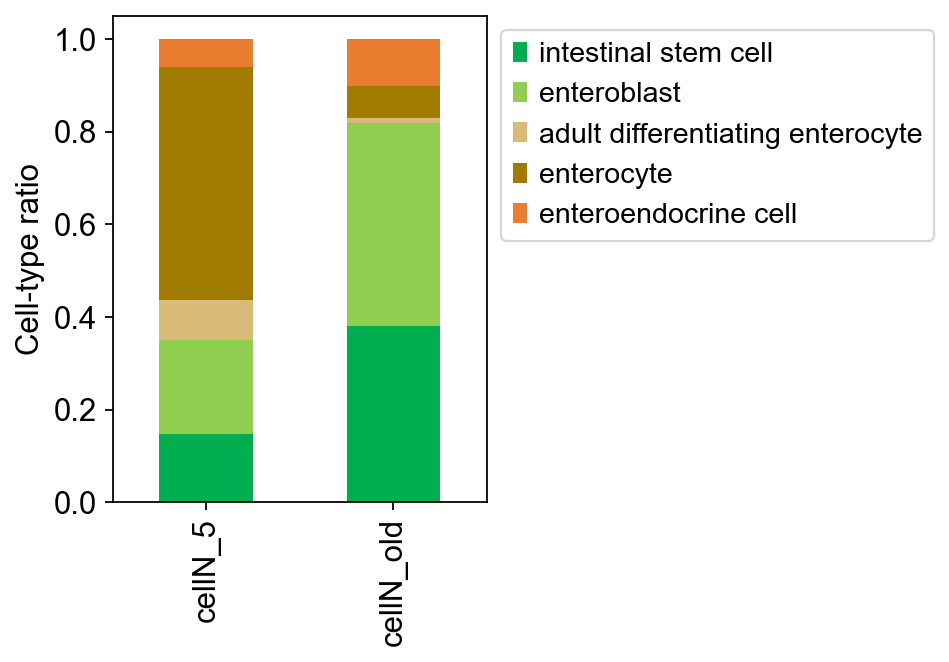

In [101]:
with rc_context({'figure.figsize': (3, 4)}):
    # ax=cellPct_Df_gut_youngOld.plot.bar(rot=90, stacked = True, color=['#1b9e77','#d95f02','#7570b3','#e7298a','#66a61e','#e6ab02'])# 
    ax=cellPct_Df_gut_youngOld.plot.bar(rot=90, stacked = True, color=["#00AE50", "#90CE50", "#D9BB77", "#A07B00", "#EB7D31"])
    ax.grid(axis='both',visible=False)
    
    plt.legend(bbox_to_anchor=(1.0, 1.0)) # ['co-clustering', ]
    plt.xlabel('')
    plt.ylabel('Cell-type ratio')
    # plt.legend(cellPct_Df_gut.columns.to_list()[::-1]) 
    # plt.xticks(rotation=90,  ticks=age_L, labels=[age_L]) # ,
    # ax.set_xticks(ticks=age_L, labels=[age_L])
    
    plt.savefig(f'{figurePicFolder}/barplot_iscDiff_youngOld.pdf', bbox_inches='tight')

In [94]:
sumList = cellN_Df_gut.sum(axis=1).to_list()
sumList

[3037, 1938, 1374, 1906]

In [95]:
# cellPct_Df_gut = cellN_Df_gut.loc[:,:]
cellPct_Df_gut = cellN_Df_gut.copy()
for i, ageN in enumerate(cellPct_Df_gut.index):
    print(ageN)
    cellPct_Df_gut.loc[ageN] = [cellN/sumList[i] for cellN in cellPct_Df_gut.loc[ageN].astype(int)]

# cellPct_Df_gut['sumRatio'] = cellPct_Df_gut.sum(axis=1)
cellPct_Df_gut

cellN_5
cellN_30
cellN_50
cellN_70


,intestinal stem cell,enteroblast,adult differentiating enterocyte,enterocyte,enteroendocrine cell
cellN_5,0.148502,0.201844,0.085940,0.504445,0.059269
cellN_30,0.323529,0.372033,0.003612,0.260578,0.040248
cellN_50,0.318777,0.491266,0.000000,0.130277,0.059680
cellN_70,0.426548,0.399265,0.016264,0.025708,0.132214


In [97]:
cellPct_Df_gut=cellPct_Df_gut.loc[:, ['intestinal stem cell', 'enteroblast', 'adult differentiating enterocyte', 'enterocyte', 'enteroendocrine cell']]

In [98]:
cellPct_Df_gut.index = [f'{age}d' for age in age_L]
cellPct_Df_gut

,intestinal stem cell,enteroblast,adult differentiating enterocyte,enterocyte,enteroendocrine cell
5d,0.148502,0.201844,0.085940,0.504445,0.059269
30d,0.323529,0.372033,0.003612,0.260578,0.040248
50d,0.318777,0.491266,0.000000,0.130277,0.059680
70d,0.426548,0.399265,0.016264,0.025708,0.132214


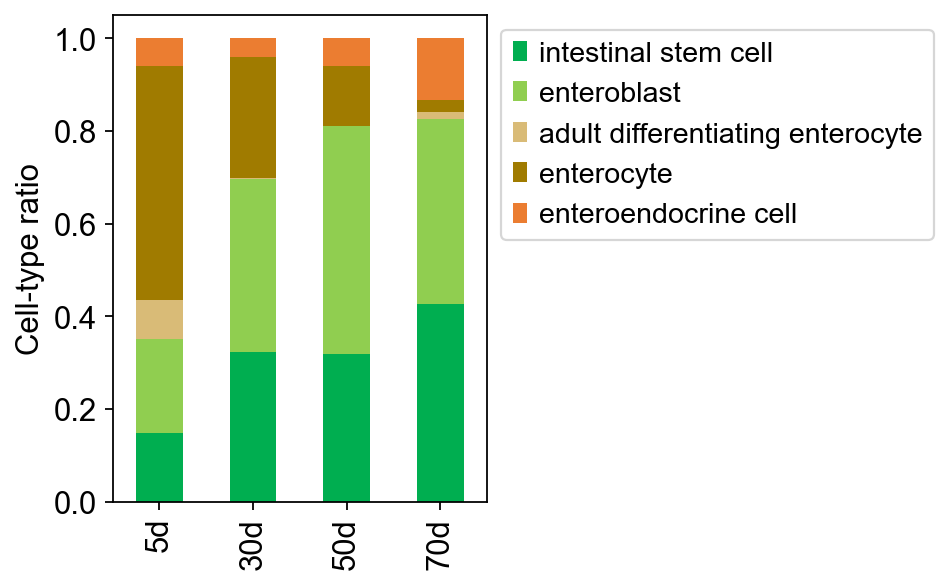

In [102]:
with rc_context({'figure.figsize': (3, 4)}):
    # ax=cellPct_Df_gut.plot.bar(rot=90, stacked = True, color=['#1b9e77','#d95f02','#7570b3','#e7298a','#66a61e','#e6ab02'])# 
    ax=cellPct_Df_gut.plot.bar(rot=90, stacked = True, color=["#00AE50", "#90CE50", "#D9BB77", "#A07B00", "#EB7D31"])
    ax.grid(axis='both',visible=False)
    
    plt.legend(bbox_to_anchor=(1.0, 1.0)) # ['co-clustering', ]
    plt.xlabel('')
    plt.ylabel('Cell-type ratio')
    # plt.legend(cellPct_Df_gut.columns.to_list()[::-1]) 
    # plt.xticks(rotation=90,  ticks=age_L, labels=[age_L]) # ,
    # ax.set_xticks(ticks=age_L, labels=[age_L])
    
    plt.savefig(f'{figurePicFolder}/barplot_iscDiff_eachAge.pdf', bbox_inches='tight')